In [2]:
import numpy as np
import h5py
import torch
import glob
import matplotlib.pyplot as plt

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-u5lwb1gk because the default path (/home/albertl_uri_edu/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
x = sorted(glob.glob('smap_l3_03km/*.h5'))
x[15]

'smap_l3_03km/SMAP_L3_SM_A_20150428_R13080_001.h5'

In [3]:
np.arange(13,25)

array([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24])

In [4]:
def x2d_torch4d(a):
    return torch.from_numpy(np.asarray(a)).unsqueeze(0).unsqueeze(0).float()


def nanmeanconv(arr,kernel_size):
   
    #input array should be 4-dim, typically [1,1,x,y]
    #kern should be the same
   
    unfold = torch.nn.Unfold(kernel_size=(kernel_size,kernel_size),stride=(kernel_size,kernel_size))
    m_unfold = unfold(arr).permute(2,0,1).reshape(-1,1,kernel_size,kernel_size)
    m_unfold_means = torch.FloatTensor([torch.nanmean(i) for i in m_unfold])
    m_nanmean_folded = torch.reshape(m_unfold_means,(arr.shape[2]//kernel_size,arr.shape[3]//kernel_size))
   
    #outputs 2d array
   
    return m_nanmean_folded

(1, 4872, 11568) 	smap_l3_03km/SMAP_L3_SM_A_20150430_R13080_001.h5
(1, 4872, 11568) 	smap_l3_03km/SMAP_L3_SM_A_20150501_R13080_001.h5
(1, 4872, 11568) 	smap_l3_03km/SMAP_L3_SM_A_20150502_R13080_001.h5
(4872, 11568)
322.8109815120697  seconds


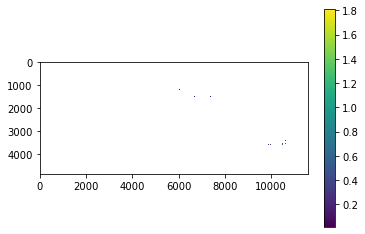

<Figure size 432x288 with 0 Axes>

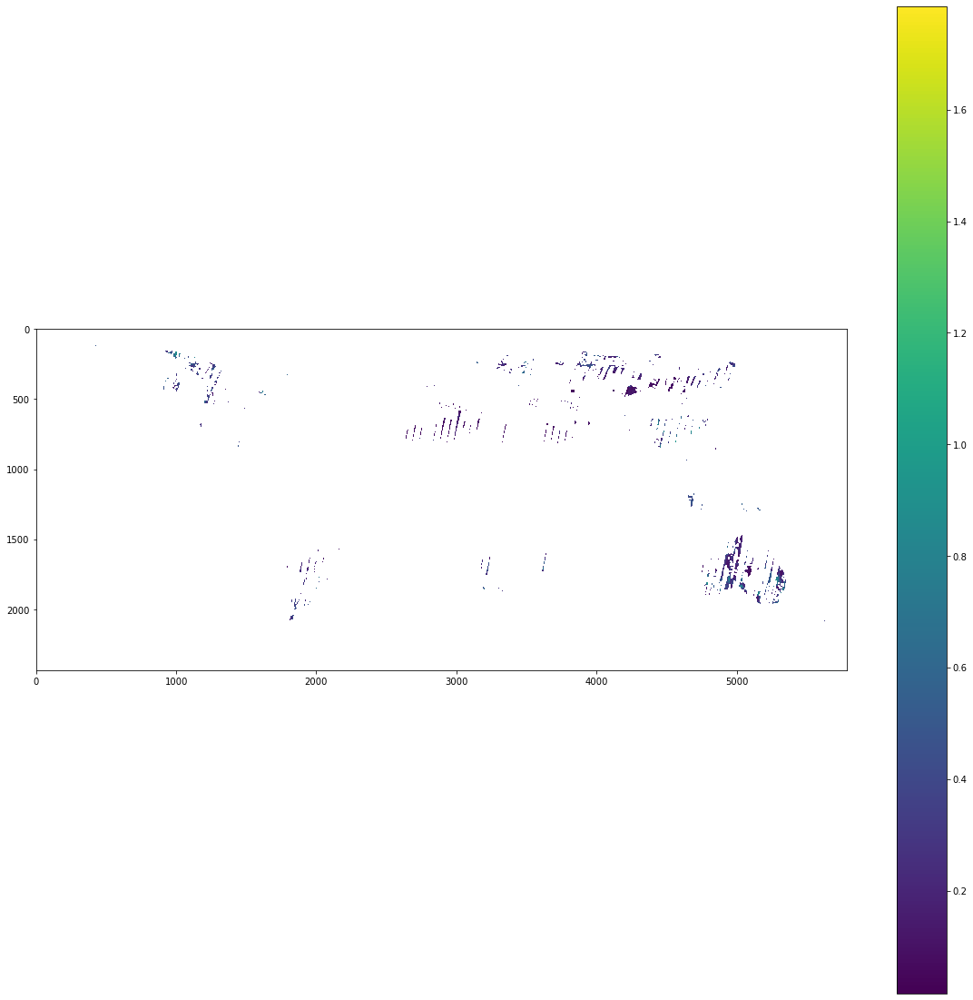

In [94]:
def open_sm(e):
    f = h5py.File(e,'r')
    var_id = list(f[group_id].keys())[18]
    sm = f[group_id][var_id][:,:]
#     sm = sm[2000:4000,2000:4000]
#     sm = sm[1108:1216,2313:2441]
    sm = np.where((sm<0),np.nan,sm)
    sm = np.expand_dims(sm,0)
#     elpaso = nanmeanconv(x2d_torch4d(elpaso),2)
    return sm

plt.figure()
z0 = open_sm(x[17]);print(z0.shape,f'\t{x[17]}')
z1 = open_sm(x[18]);print(z1.shape,f'\t{x[18]}')
z2 = open_sm(x[19]);print(z2.shape,f'\t{x[19]}')
z3 = np.nansum((z0,z1,z2),axis=0)[0]
z3 = np.where(z3<=0,np.nan,z3)
z2 = z3
print(z3.shape)
plt.imshow(z3)
plt.colorbar()

plt.figure()
t0 = time.time()
z4 = nanmeanconv(x2d_torch4d(z3),2)
t1 = time.time()
print(t1-t0,' seconds')
plt.figure(figsize=(20,20))
plt.gca().set_aspect('equal')
plt.imshow(z4)
plt.colorbar()

In [90]:
import time

211.2379186153412  seconds


<Figure size 432x288 with 0 Axes>

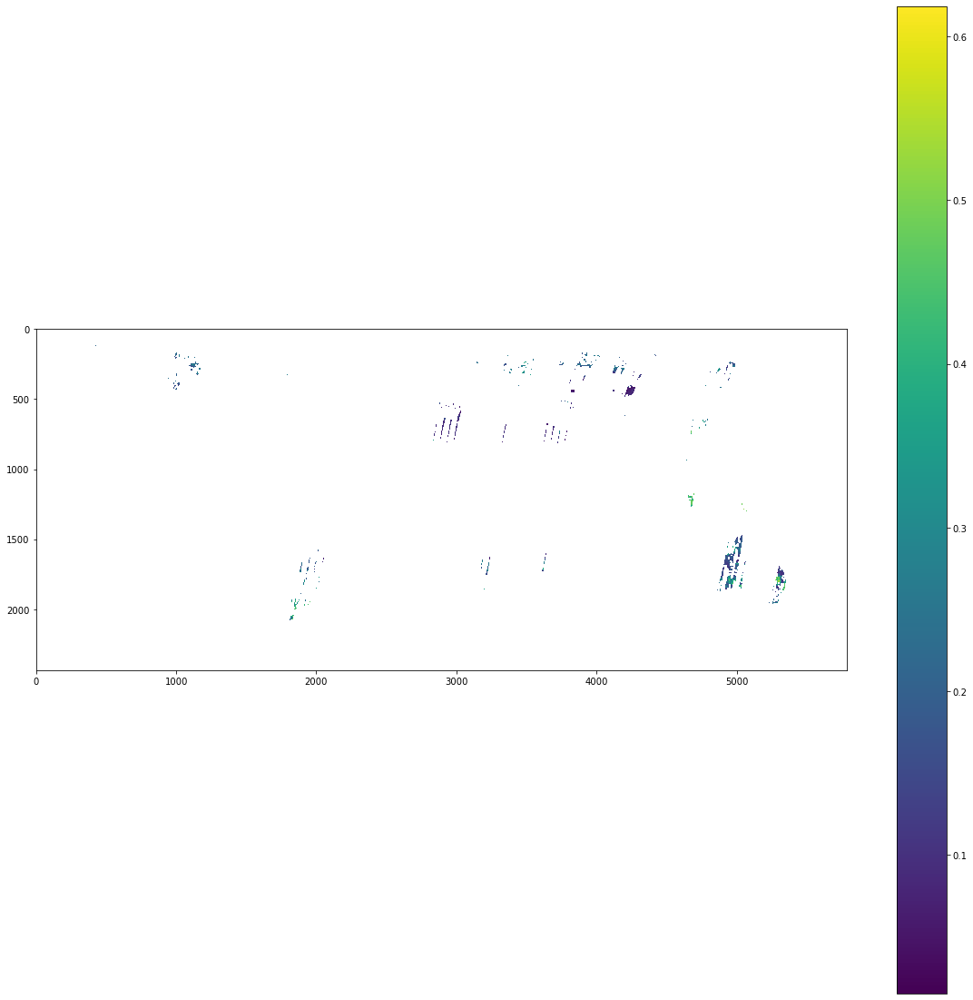

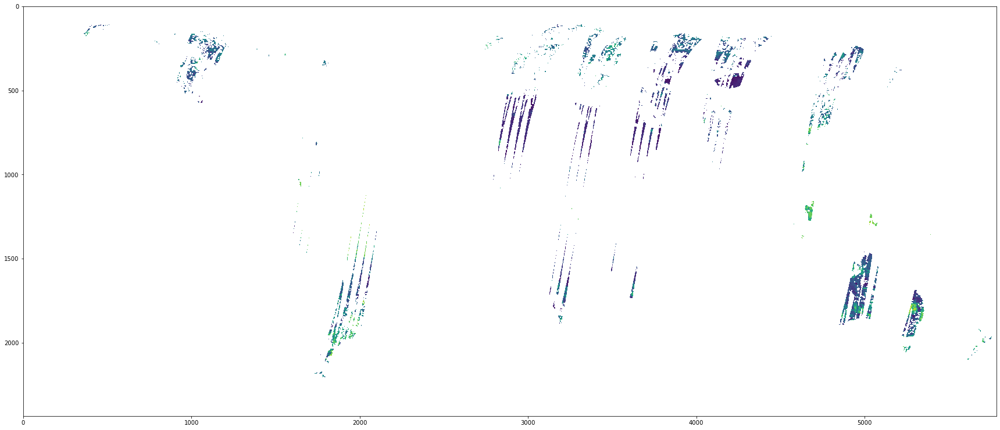

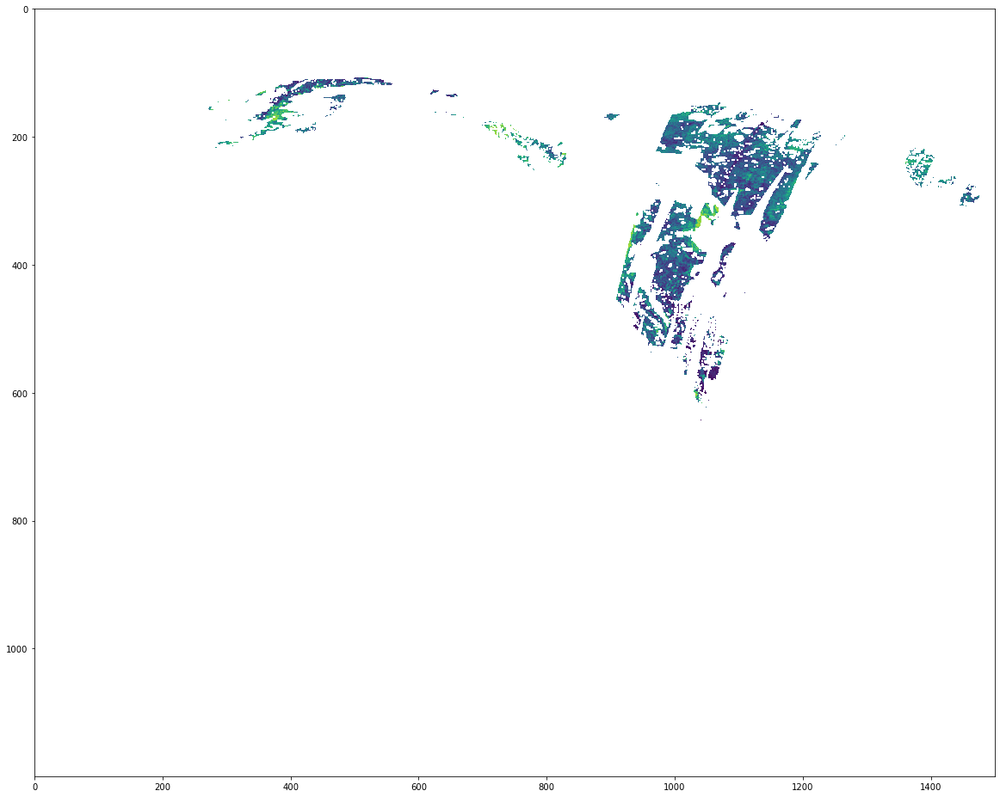

In [86]:
plt.figure(figsize=(30,30))
plt.imshow(z3)

plt.figure(figsize=(20,20))
plt.imshow(z3[0:1200,0:1500])

In [55]:
one = np.linspace(0,1624,1624)
two = np.linspace(0,3856,3856)
lat,lon = np.meshgrid(one,two,indexing='ij')
lon.shape

(1624, 3856)

KeyboardInterrupt: 

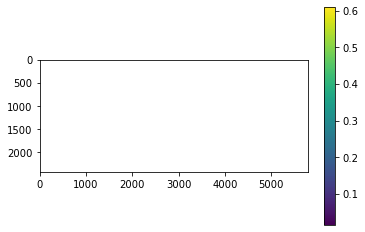

In [72]:
x = sorted(glob.glob('smap_l3_03km/*.h5'))

for y in np.arange(13,20):
    f = h5py.File(x[y],'r')

#     print('By using the command h5py.File() a filehandle is returned:')
#     print(f); print('\n')

#     print("Now lets look at the groups within the file to access:")
    i=0;
    for key in f.keys():
#         print(str(i)+ '\t'+key)
        i+=1


    # group_choice = int(input('group choice?: \t'))
    group_choice = 3
    group_id=list(f.keys())[group_choice];# < Lets focus on the AM overpass for this example
#     print('\n')
    i=0
#     print(f"Now lets look at the variables within the filegroup {group_id} to access the actual data:")
    for var in list(f[group_id].keys()):
#         print(str(i)+'\t'+var)
        i+=1
#     print('the data has a shape of: '+str(f[group_id][list(f[group_id].keys())[0]].shape))

    # var_you_want = int(input('variable?: \t'))
    var_id = list(f[group_id].keys())[4] # lat
    sm_lat = f[group_id][var_id][:,:]
    var_id = list(f[group_id].keys())[5] # lon
    sm_lon = f[group_id][var_id][:,:]
    var_id = list(f[group_id].keys())[18] # sm
    sm = f[group_id][var_id][:,:]
    # print('data are returned as '+str(type(sm_lon)) + ' something easy to work with in python.')

#     slovenia = sm[651:710,6202:6329]
#     slovenia = np.where((slovenia<0),np.nan,slovenia)
#     plt.figure()
#     plt.imshow(slovenia)
#     plt.colorbar()

    sm = np.where((sm<0),np.nan,sm)
    sm = nanmeanconv(x2d_torch4d(sm),2)
    
#     yukon = sm[0:200,150:400]
#     yukon = np.where((yukon<0),np.nan,yukon)
#     yukon = nanmeanconv(x2d_torch4d(yukon),2)

    plt.figure()
    plt.imshow(sm)
    plt.colorbar()

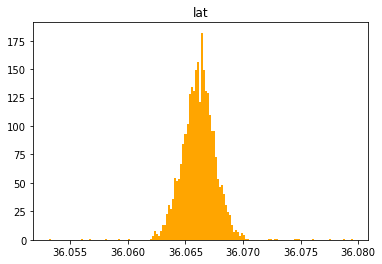

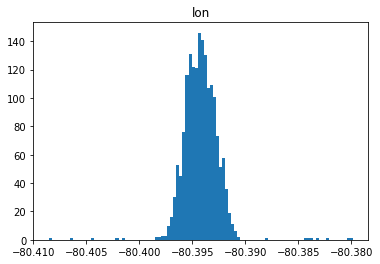

In [121]:
##looks to see if there are values at given lat / lon


lat_line = sm_lat[1000]
lat_line_nans = np.where((lat_line>90) | (lat_line<-90),np.nan,lat_line)
plt.figure()
plt.hist(lat_line_nans.reshape(-1),bins=150,color='orange');
plt.title('lat');

lon_line = sm_lon[:,3200]
lon_line_nans = np.where((lon_line>180) | (lon_line<-180),np.nan,lon_line)
plt.figure()
plt.hist(lon_line_nans.reshape(-1),bins=100);
plt.title('lon');

In [111]:
# for x in lat_line:
#     print(x)

In [112]:
sm_lat_nonans = np.where(sm_lat<-90,np.nan,sm_lat)
sm_lon_nonans = np.where(sm_lon<-180,np.nan,sm_lon)

In [113]:
sm_lat_means = np.nanmean(sm_lat_nonans,axis=1)
sm_lon_means = np.nanmean(sm_lon_nonans,axis=0)

/tmp/ipykernel_2615641/4255450734.py:1: RuntimeWarning: Mean of empty slice
  sm_lat_means = np.nanmean(sm_lat_nonans,axis=1)


([<matplotlib.axis.YTick at 0x7f7262d46d30>,
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

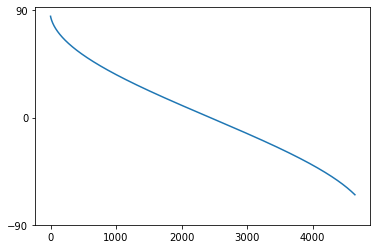

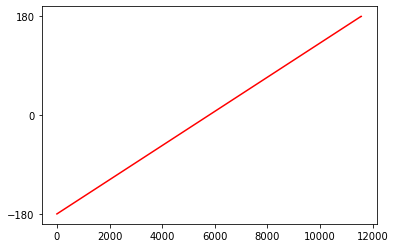

In [114]:
plt.figure()
plt.plot(sm_lat_means)
plt.yticks((-90,0,90));

plt.figure()
plt.plot(sm_lon_means,color='red')
plt.yticks((-180,0,180))

In [115]:
sm_lat_means.shape

(4872,)

In [143]:
latbool = np.argwhere((sm_lat_means<33) & (sm_lat_means>30))
lonbool = np.argwhere((sm_lon_means<-104) & (sm_lon_means>-108))

In [144]:
print(np.min(latbool))
print(np.max(latbool))
print(np.min(lonbool))
print(np.max(lonbool))

1108
1216
2313
2441


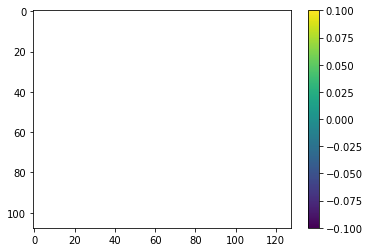

In [146]:
elpaso = sm[1108:1216,2313:2441]
elpaso = np.where((elpaso<0),np.nan,elpaso)
plt.imshow(elpaso)
plt.colorbar()

In [67]:
sm_lon.shape

(4872, 11568)

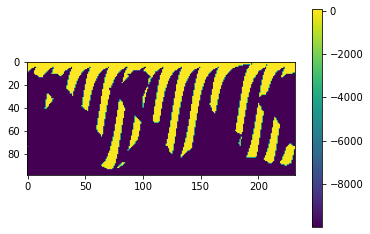

In [39]:
plt.imshow(sm_lat[::50,::50])
plt.colorbar()

In [74]:
sm_lon[-1,-1]

-9999.0

In [79]:
lon = np.linspace(-180,180,11568)
lat = np.linspace(-90,90,4872)

lonn, latt = np.meshgrid(lon,lat,indexing='xy')

In [80]:
lonn.shape

(4872, 11568)

In [85]:
latt[0,0]

-90.0

In [86]:
sm_lat[0]

array([85.147995, 85.152794, 85.156044, ..., 85.143555, 85.13262 ,
       85.14722 ], dtype=float32)

## trying to combine files, 3/29/22

In [39]:
f'smlatlon{x[42][26:34]}.npy'

'smlatlon20150526.npy'

In [8]:
x = sorted(glob.glob('smap_l3_03km/*.h5'))
xtarg = x[42]
f = h5py.File(xtarg,'r')

for idk,key in enumerate(f.keys()):
    print(idk,key)
print('\n')
group_id = list(f.keys())[3]
for idv,var in enumerate(list(f[group_id].keys())):
    print(idv,var)

sm_idx = list(f[group_id].keys())[18]
sm_lat = list(f[group_id].keys())[4]
sm_lon = list(f[group_id].keys())[5]

f[group_id][sm_idx].chunks

# print('\n')
# print(f'filename: \t {xtarg}')
# sm = np.expand_dims(np.asarray(f[group_id][sm_idx]),0); print(f'sm shape: \t {sm.shape}')
# lat = np.expand_dims(np.asarray(f[group_id][sm_lat]),0); print(f'lat shape: \t {lat.shape}')
# lon = np.expand_dims(np.asarray(f[group_id][sm_lon]),0); print(f'lon shape: \t {lon.shape}')

# tensor = np.concatenate((sm,lat,lon),axis=0)
# tensor.shape
# np.save(f'smap_l3_03km_np/smlatlon{x[42][26:34]}.npy',tensor)

0 Ancillary_Data
1 Metadata
2 Radar_Data
3 Soil_Moisture_Retrieval_Data


0 EASE_column_index
1 EASE_row_index
2 bare_soil_roughness_retrieved
3 distance_from_nadir
4 latitude
5 longitude
6 num_input_sigma0s_hh
7 num_input_sigma0s_vv
8 num_input_sigma0s_xpol
9 num_time_series
10 radar_vegetation_index
11 radar_water_flag3
12 retrieval_qual_flag
13 retrieval_qual_flag_change_index
14 retrieval_qual_flag_kvz
15 sigma0_qual_flag_hh
16 sigma0_qual_flag_vv
17 sigma0_qual_flag_xpol
18 soil_moisture
19 soil_moisture_change_index
20 soil_moisture_error
21 soil_moisture_kvz
22 soil_moisture_snapshot
23 soil_moisture_snapshot_DVZ
24 soil_moisture_snapshot_shi
25 spacecraft_overpass_time_seconds
26 spacecraft_overpass_time_utc
27 surface_flag


(1, 11568)

In [42]:
x = sorted(glob.glob('smap_l3_03km/*.h5'))

for xtarg in x:
    f = h5py.File(xtarg,'r')
#     for idk,key in enumerate(f.keys()):
#         print(idk,key)
#     print('\n')
    group_id = list(f.keys())[3]
#     for idv,var in enumerate(list(f[group_id].keys())):
#         print(idv,var)
    sm_idx = list(f[group_id].keys())[18]
    sm_lat = list(f[group_id].keys())[4]
    sm_lon = list(f[group_id].keys())[5]

    print('\n')
    print(f'filename: \t {xtarg}')
    sm = np.expand_dims(np.asarray(f[group_id][sm_idx]),0); print(f'sm shape: \t {sm.shape}')
    lat = np.expand_dims(np.asarray(f[group_id][sm_lat]),0); print(f'lat shape: \t {lat.shape}')
    lon = np.expand_dims(np.asarray(f[group_id][sm_lon]),0); print(f'lon shape: \t {lon.shape}')

    tensor = np.concatenate((sm,lat,lon),axis=0)
    tensor.shape
    np.save(f'smap_l3_03km_np/smlatlon{xtarg[26:34]}.npy',tensor)



filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150413_R13080_002.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150414_R13080_001.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150415_R13080_001.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150416_R13080_001.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150417_R13080_001.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150418_R13080_001.h5
sm shape: 	 (1, 4872, 11568)
lat shape: 	 (1, 4872, 11568)
lon shape: 	 (1, 4872, 11568)


filename: 	 smap_l3_03km/SMAP_L3_SM_A_20150419_R13080_001.h5
sm shape: 	 (1, 4872, 115

In [24]:
#creates a ten day nanmean of soil moisture radar data

x = glob.glob('smap_l3_03km_np/*.npy')
y = np.empty((0,4872,11568))

cnt = 0
for i in x:
    j = np.expand_dims(np.load(i)[1],0) #[0] is sm, [1] is lat, [2] is lon
    y = np.concatenate((y,j),0)
    cnt += 1; print(cnt)
    if cnt == 10:
        break
y = np.where(y<-200,np.nan,y)
yHat = np.nanmean(y,axis=0)

1
2
3
4
5
6
7
8
9
10


/tmp/ipykernel_711070/1422594642.py:14: RuntimeWarning: Mean of empty slice
  yHat = np.nanmean(y,axis=0)


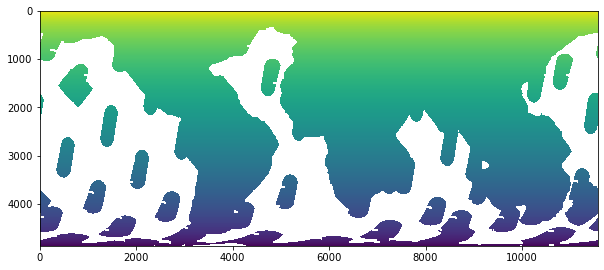

In [30]:
plt.figure(figsize=(10,10))
plt.gca().set_aspect('equal')
plt.imshow(yHat)

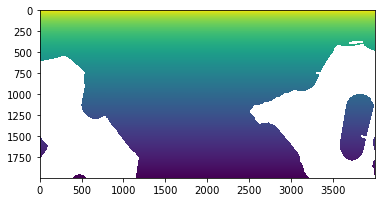

In [32]:
plt.imshow(yHat[0:2000,1000:5000])

1
2
3
4
5
6
7
8
9
10


/tmp/ipykernel_711070/2601672233.py:12: RuntimeWarning: Mean of empty slice
  yHat = np.nanmean(y,axis=0)


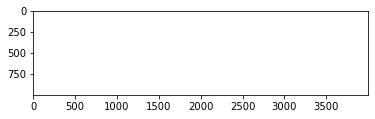

In [34]:
x = glob.glob('smap_l3_03km_np/*.npy')
y = np.empty((0,4872,11568))

cnt = 0
for i in x:
    j = np.expand_dims(np.load(i)[0],0) #[0] is sm, [1] is lat, [2] is lon
    y = np.concatenate((y,j),0)
    cnt += 1; print(cnt)
    if cnt == 10:
        break
y = np.where(y<-200,np.nan,y)
yHat = np.nanmean(y,axis=0)
plt.imshow(yHat[1000:2000,1000:5000])

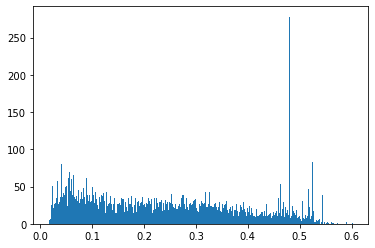

In [38]:
plt.hist(yHat.reshape(-1),bins=500);

In [39]:
def x2d_torch4d(a):
    return torch.from_numpy(np.asarray(a)).unsqueeze(0).unsqueeze(0).float()


def nanmeanconv(arr,kernel_size):
   
    #input array should be 4-dim, typically [1,1,x,y]
    #kern should be the same
   
    unfold = torch.nn.Unfold(kernel_size=(kernel_size,kernel_size),stride=(kernel_size,kernel_size))
    m_unfold = unfold(arr).permute(2,0,1).reshape(-1,1,kernel_size,kernel_size)
    m_unfold_means = torch.FloatTensor([torch.nanmean(i) for i in m_unfold])
    m_nanmean_folded = torch.reshape(m_unfold_means,(arr.shape[2]//kernel_size,arr.shape[3]//kernel_size))
   
    #outputs 2d array
   
    return m_nanmean_folded
yHat6km = nanmeanconv(x2d_torch4d(yHat),2)

In [40]:
yHat6km = nanmeanconv(x2d_torch4d(yHat),2)

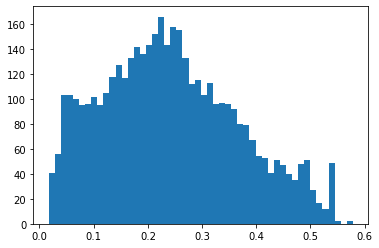

In [47]:
plt.hist(yHat6km.numpy().reshape(-1),bins=50);

In [46]:
yHat6km.shape

torch.Size([2436, 5784])

In [ ]:
#     slovenia = sm[651:710,6202:6329]
#     slovenia = np.where((slovenia<0),np.nan,slovenia)
#     plt.figure()
#     plt.imshow(slovenia)
#     plt.colorbar()

In [51]:
#creates a ten day nanmean of soil moisture radar data

x = glob.glob('smap_l3_03km_np/*.npy')
y = np.empty((0,59,127))
cnt=0
for i in x:
    j = np.expand_dims(np.load(i)[0][651:710,6202:6329],0) #[0] is sm, [1] is lat, [2] is lon
    y = np.concatenate((y,j),0)
    cnt += 1; 
    print(cnt,y.shape)
y = np.where(y<-200,np.nan,y)
yHat = np.nanmean(y,axis=0)

1 (1, 59, 127)
2 (2, 59, 127)
3 (3, 59, 127)
4 (4, 59, 127)
5 (5, 59, 127)
6 (6, 59, 127)
7 (7, 59, 127)
8 (8, 59, 127)
9 (9, 59, 127)
10 (10, 59, 127)
11 (11, 59, 127)
12 (12, 59, 127)
13 (13, 59, 127)
14 (14, 59, 127)
15 (15, 59, 127)
16 (16, 59, 127)
17 (17, 59, 127)
18 (18, 59, 127)
19 (19, 59, 127)
20 (20, 59, 127)
21 (21, 59, 127)
22 (22, 59, 127)
23 (23, 59, 127)
24 (24, 59, 127)
25 (25, 59, 127)
26 (26, 59, 127)
27 (27, 59, 127)
28 (28, 59, 127)
29 (29, 59, 127)
30 (30, 59, 127)
31 (31, 59, 127)
32 (32, 59, 127)
33 (33, 59, 127)
34 (34, 59, 127)
35 (35, 59, 127)
36 (36, 59, 127)
37 (37, 59, 127)
38 (38, 59, 127)
39 (39, 59, 127)
40 (40, 59, 127)
41 (41, 59, 127)
42 (42, 59, 127)
43 (43, 59, 127)
44 (44, 59, 127)
45 (45, 59, 127)
46 (46, 59, 127)
47 (47, 59, 127)
48 (48, 59, 127)
49 (49, 59, 127)
50 (50, 59, 127)
51 (51, 59, 127)
52 (52, 59, 127)
53 (53, 59, 127)
54 (54, 59, 127)
55 (55, 59, 127)
56 (56, 59, 127)
57 (57, 59, 127)
58 (58, 59, 127)
59 (59, 59, 127)
60 (60, 59, 127

/tmp/ipykernel_711070/971792913.py:12: RuntimeWarning: Mean of empty slice
  yHat = np.nanmean(y,axis=0)


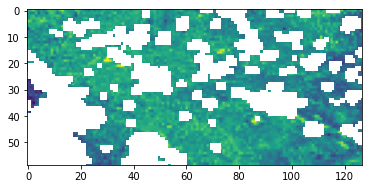

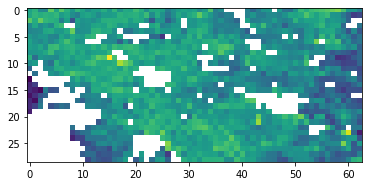

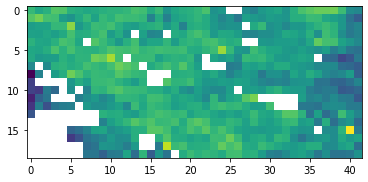

In [54]:
plt.imshow(yHat)

yHat6km = nanmeanconv(x2d_torch4d(yHat),2)
plt.figure()
plt.imshow(yHat6km)

yHat9km = nanmeanconv(x2d_torch4d(yHat),3)
plt.figure()
plt.imshow(yHat9km)

In [63]:
x.nbytes

225437184

In [81]:
x1 = np.where(x==np.nan,0,1)
print(x1.nbytes/1000000000*84)
x1 = np.array(x1,dtype='uint8')
print(x1.nbytes/1000000000*84)

37.873446912000006
4.734180864000001


In [65]:
x1.shape

(4872, 11568)

In [66]:
type(x1)

numpy.ndarray

In [82]:
y = np.zeros((4872,11568),dtype='uint8')

In [86]:
y.nbytes/(1e9)

0.056359296

In [3]:
x = glob.glob('smap_l3_03km_np/*.npy')
y = np.zeros((4872,11568),dtype='uint8')
cnt=0
for i in x:
    j = np.load(i)[0]
    j = np.where(j<=-200,0,1)
    j = np.array(j,dtype='uint8')
    y = np.add(y,j)
    cnt += 1; 
    print(cnt,y.shape)

1 (4872, 11568)
2 (4872, 11568)
3 (4872, 11568)
4 (4872, 11568)
5 (4872, 11568)
6 (4872, 11568)
7 (4872, 11568)
8 (4872, 11568)
9 (4872, 11568)
10 (4872, 11568)
11 (4872, 11568)
12 (4872, 11568)
13 (4872, 11568)
14 (4872, 11568)
15 (4872, 11568)
16 (4872, 11568)
17 (4872, 11568)
18 (4872, 11568)
19 (4872, 11568)
20 (4872, 11568)
21 (4872, 11568)
22 (4872, 11568)
23 (4872, 11568)
24 (4872, 11568)
25 (4872, 11568)
26 (4872, 11568)
27 (4872, 11568)
28 (4872, 11568)
29 (4872, 11568)
30 (4872, 11568)
31 (4872, 11568)
32 (4872, 11568)
33 (4872, 11568)
34 (4872, 11568)
35 (4872, 11568)
36 (4872, 11568)
37 (4872, 11568)
38 (4872, 11568)
39 (4872, 11568)
40 (4872, 11568)
41 (4872, 11568)
42 (4872, 11568)
43 (4872, 11568)
44 (4872, 11568)
45 (4872, 11568)
46 (4872, 11568)
47 (4872, 11568)
48 (4872, 11568)
49 (4872, 11568)
50 (4872, 11568)
51 (4872, 11568)
52 (4872, 11568)
53 (4872, 11568)
54 (4872, 11568)
55 (4872, 11568)
56 (4872, 11568)
57 (4872, 11568)
58 (4872, 11568)
59 (4872, 11568)
60 (48

In [88]:
y.shape

(4872, 11568)

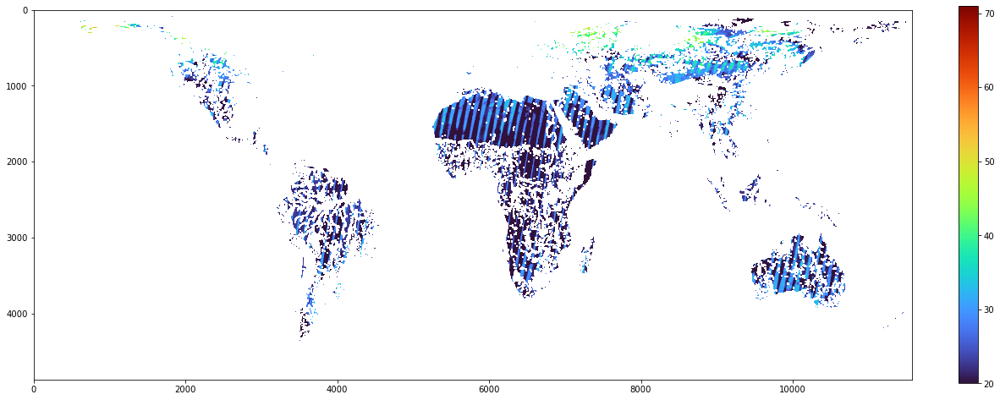

In [161]:
plt.figure(figsize=(20,20))
plt.imshow(np.where(y<=0,np.nan,y),vmin=20,cmap='turbo')
plt.colorbar(fraction=.02)

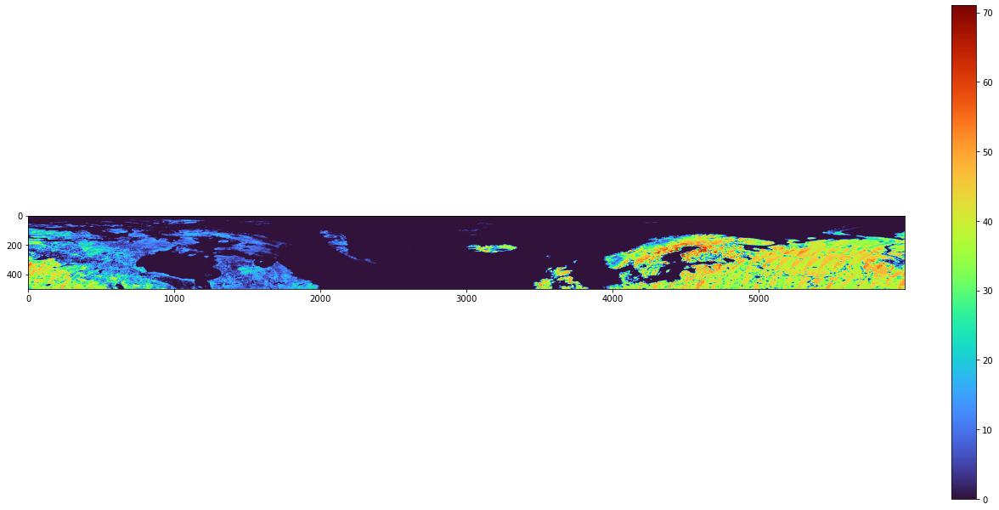

In [151]:
plt.figure(figsize=(20,20))
plt.imshow(y[0:500,2000:8000],cmap='turbo')
plt.colorbar(fraction=.026)

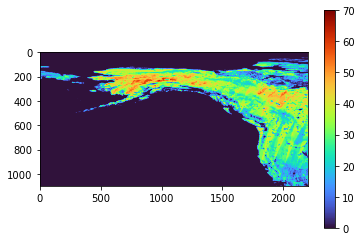

In [145]:
plt.figure()
plt.imshow(y[0:1100,0:2200],cmap='turbo')
plt.colorbar()

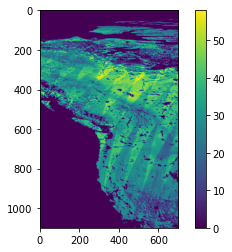

In [108]:
plt.figure()
plt.imshow(y[0:1100,1500:2200])
plt.colorbar()

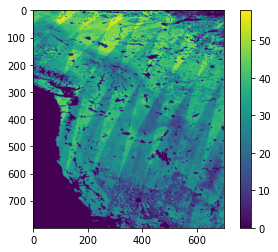

In [133]:
plt.figure()
plt.imshow(y[300:1100,1700:2400])
plt.colorbar()

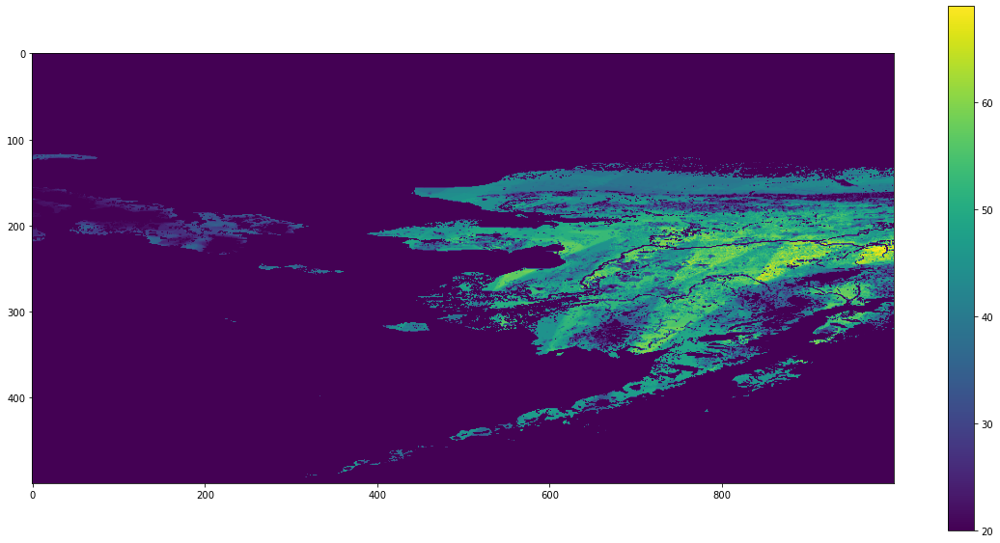

In [130]:
plt.figure(figsize=(20,10))
plt.gca().set_aspect('equal')
plt.imshow(y[0:500,0:1000],vmin=20)
plt.colorbar()

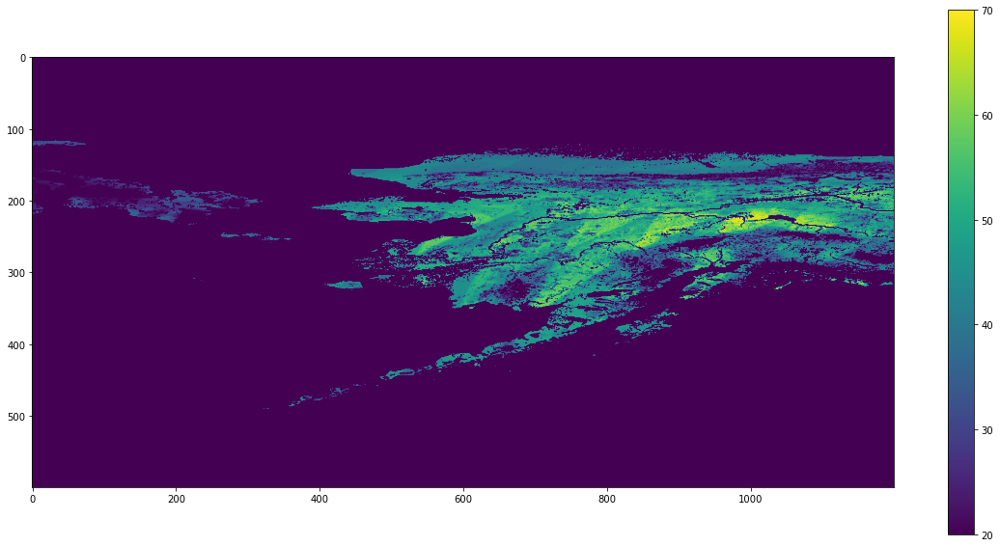

In [149]:
plt.figure(figsize=(20,10))
plt.gca().set_aspect('equal')
plt.imshow(y[0:600,0:1200],vmin=20)
plt.colorbar()

In [150]:
600/12

50.0

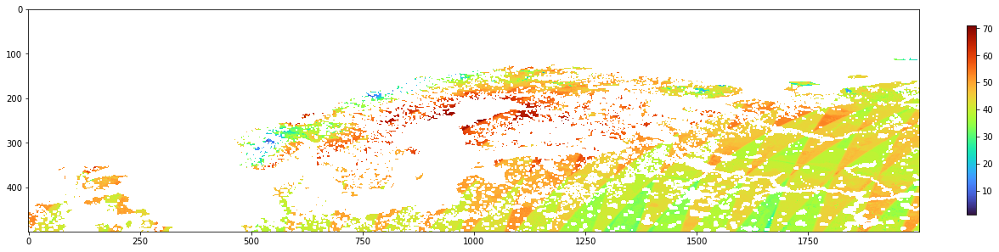

In [174]:
plt.figure(figsize=(20,20))
plt.imshow(np.where(y<=0,np.nan,y)[0:500,5500:7500],cmap='turbo')
plt.colorbar(fraction=.01)

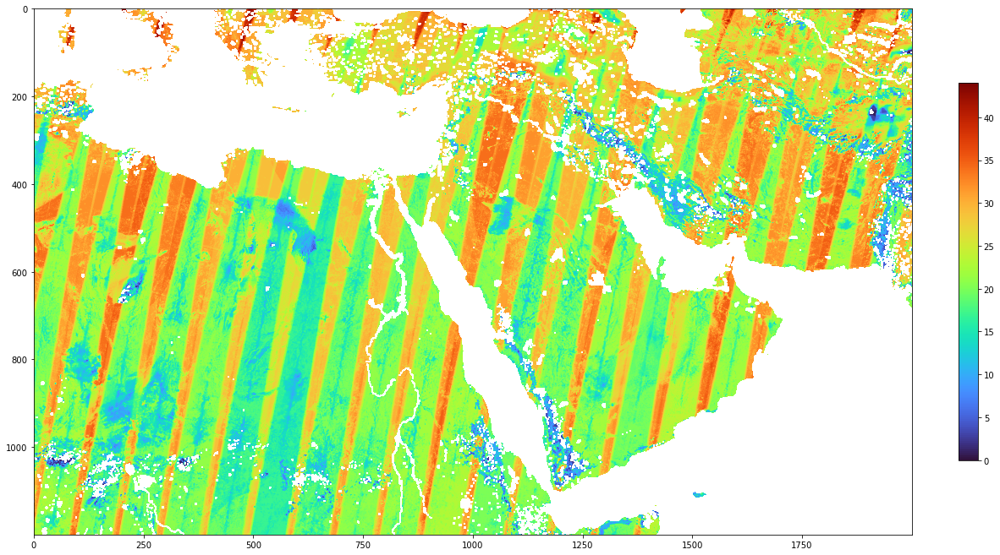

In [183]:
plt.figure(figsize=(20,20))
plt.imshow(np.where(y<=0,np.nan,y)[800:2000,6000:8000],vmin=0,cmap='turbo')
plt.colorbar(fraction=.02)

In [5]:
import matplotlib.colors
cmap = matplotlib.colors.ListedColormap(['black', 'lightblue'])

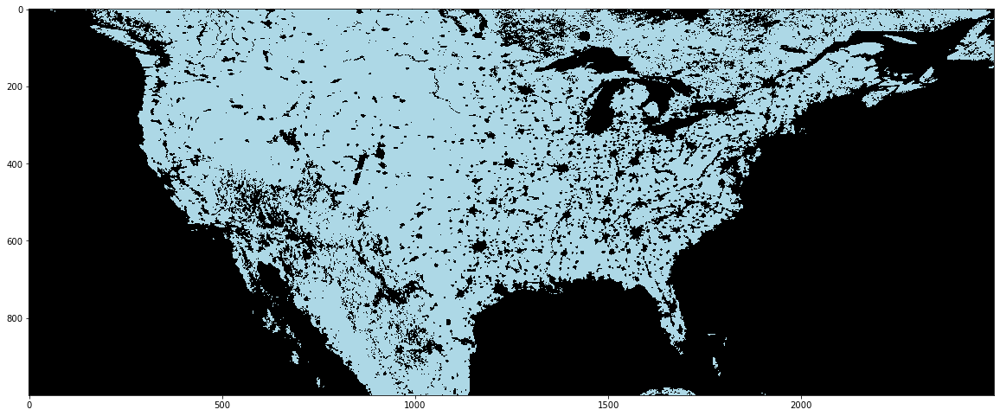

In [231]:
import matplotlib.colors
cmap = matplotlib.colors.ListedColormap(['black', 'lightblue'])plt.figure(figsize=(20,20))
plt.imshow(np.array(np.where(y>10,1,0),dtype='b')[500:1500,1500:4000],vmin=0,cmap=cmap)
# plt.colorbar(fraction=.02)

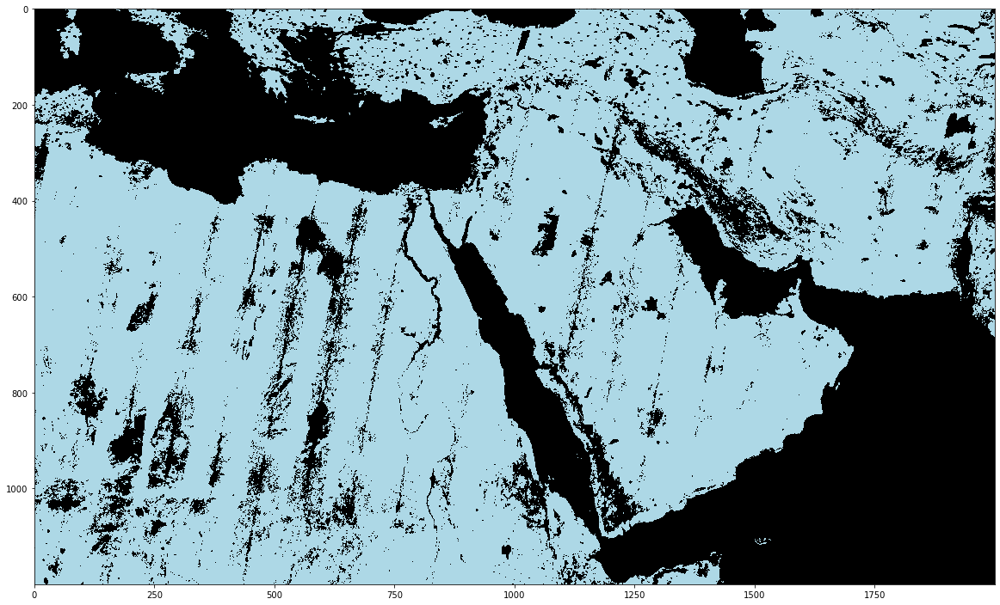

In [234]:
plt.figure(figsize=(20,20))
plt.imshow(np.where(y>15,1,0)[800:2000,6000:8000],vmin=0,cmap=cmap)
# plt.colorbar(fraction=.02)

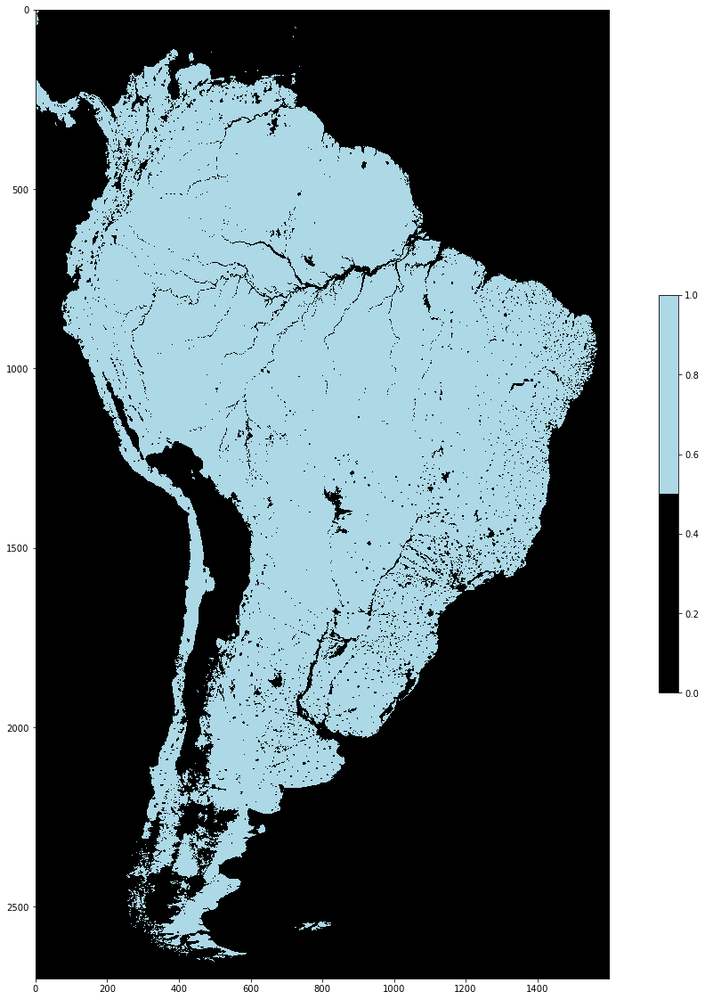

In [252]:
plt.figure(figsize=(20,20))
# plt.imshow(np.where(y>10,1,0)[1800:4500,3100:4700],cmap='jet')
plt.imshow(np.array(np.where(y>10,1,0),dtype='b')[1800:4500,3100:4700],vmin=0,cmap=cmap)
# plt.colorbar(fraction=.02)

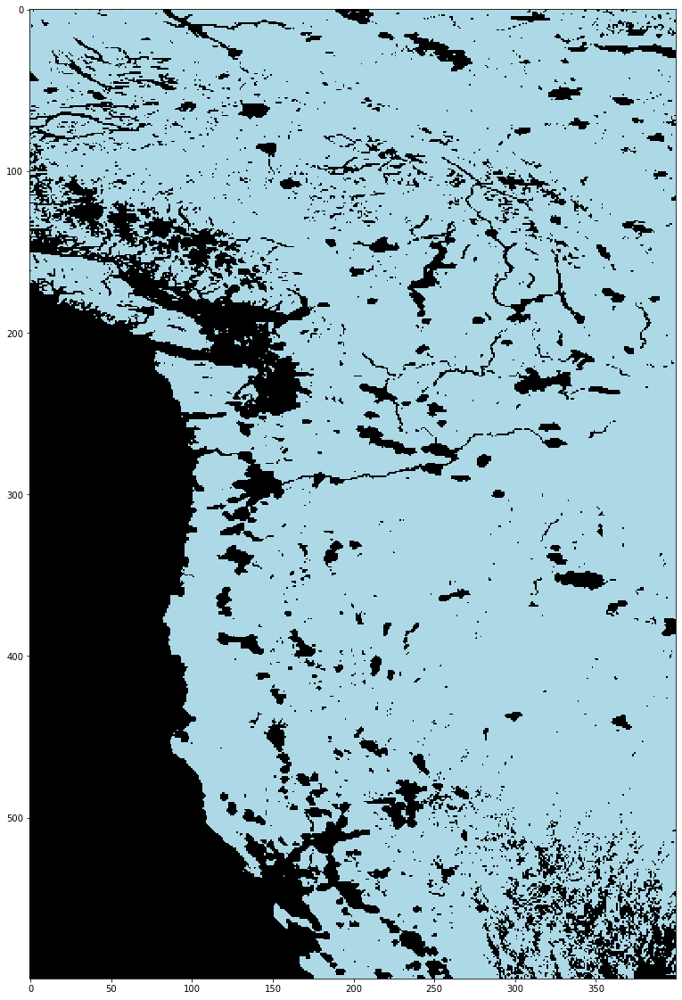

In [251]:
plt.figure(figsize=(20,20))
plt.imshow(np.array(np.where(y>10,1,0),dtype='b')[400:1000,1700:2100],vmin=0,cmap=cmap)

Text(0.5, 1.0, 'amazon river more than 10 radar occurrences in blue')

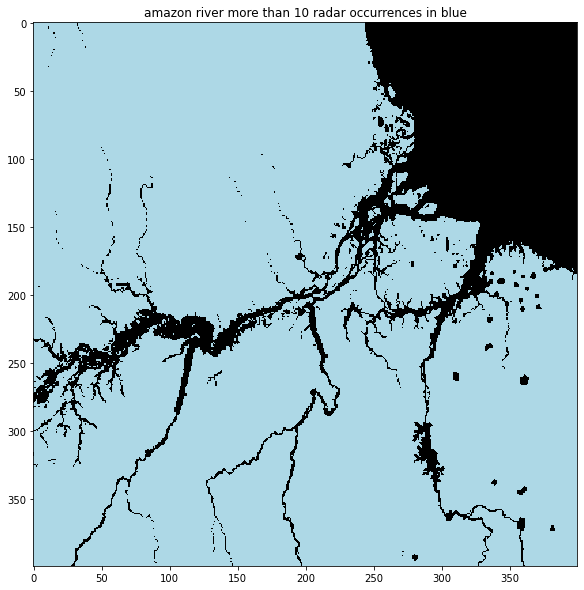

In [9]:
plt.figure(figsize=(10,10))
ytarg = 10 #number of occurrences
plt.imshow(np.array(np.where(y>ytarg,1,0),dtype='b')[2300:2700,3900:4300],vmin=0,cmap=cmap)
plt.title(f'amazon river more than {ytarg} radar occurrences in blue')

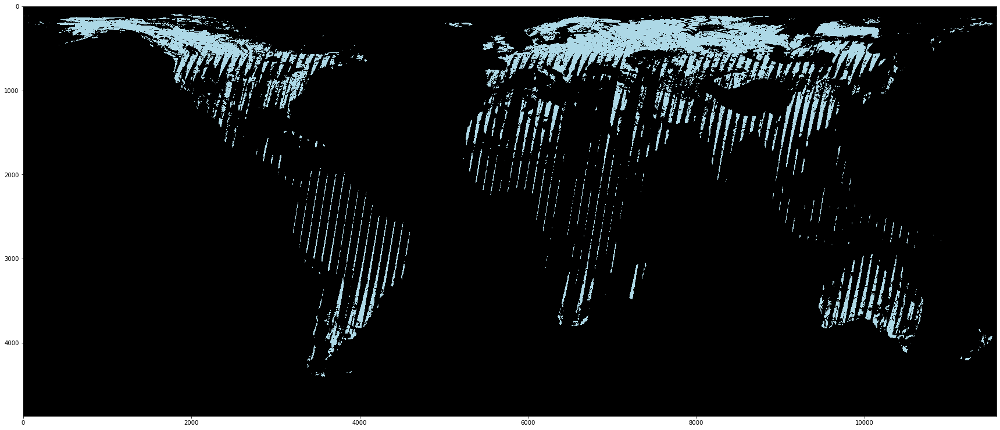

In [291]:
plt.figure(figsize=(30,30))
plt.imshow(np.array(np.where(y>30,1,0),dtype='b'),vmin=0,cmap=cmap)

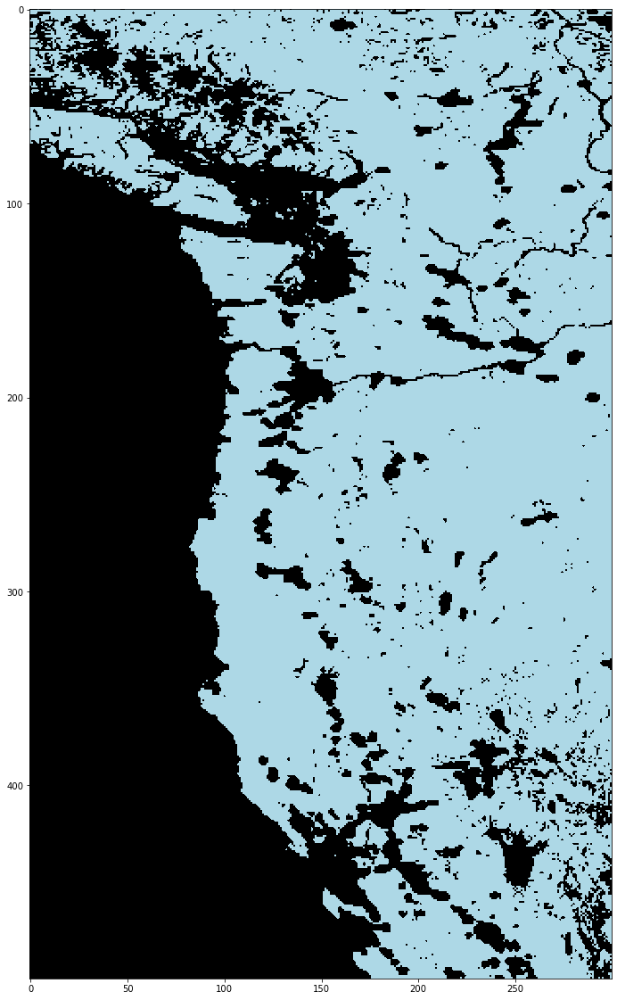

In [303]:
plt.figure(figsize=(20,20))
plt.imshow(np.array(np.where(y>15,1,0),dtype='b')[500:1000,1700:2000],vmin=0,cmap=cmap)

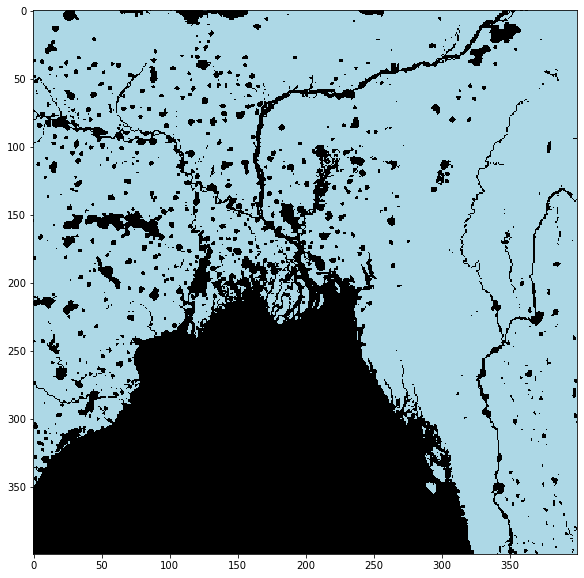

In [13]:
plt.figure(figsize=(10,10))
plt.imshow(np.array(np.where(y>5,1,0)[1300:1700,8500:8900],dtype='b'),vmin=0,cmap=cmap)

In [14]:
x = glob.glob('smap_l3_03km_np/*.npy')
len(x)

84

In [40]:
# for y in x:
#     print(y)
#     z = np.load(y)
#     a = z[:,2300:2700,3900:4300]
#     b = np.where(a <= -200, np.nan, a)
#     print(b.shape)
#     np.save(f'smap_l3_03km_np_amazon/amzn{y[16:]}',b)

In [341]:
x = glob.glob('smap_l3_03km_np_amazon/*.npy')
len(x)
arr = np.empty((0,396,396))

for y in x:
    z = np.load(y)[:,:-4,:-4]
    a = np.expand_dims(z[0],0)
#     print(a.shape)
    arr = np.concatenate((a,arr),axis=0)
#     print(arr.shape)
#     break
arrmean = np.nanmean(arr,axis=0)
arrmeantile = np.tile(arrmean,(84,1,1))

print(arr.shape)
print(arrmeantile.shape)

arr_replacenans = np.where(np.isfinite(arr)==False,arrmeantile,arr)
print(arr_replacenans.shape)

arr6km = torch.empty((0,198,198))
for x in arr_replacenans:
#     print(x.shape)
    arr6kmtemp = nanmeanconv(x2d_torch4d(x),2).unsqueeze(0)
    arr6kmtemp = torch.where(torch.isfinite(arr6kmtemp) == False,torch.nanmean(arr6kmtemp),arr6kmtemp)
#     print(arr6kmtemp.shape)
    arr6km = torch.cat((arr6km,arr6kmtemp),axis=0)
print(arr6km.shape)

/tmp/ipykernel_647923/3973213934.py:12: RuntimeWarning: Mean of empty slice
  arrmean = np.nanmean(arr,axis=0)


(84, 396, 396)
(84, 396, 396)
(84, 396, 396)
torch.Size([84, 198, 198])


/tmp/ipykernel_647923/2742530493.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


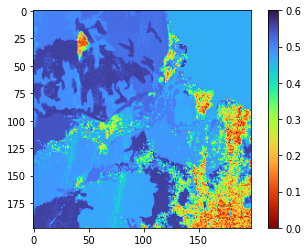

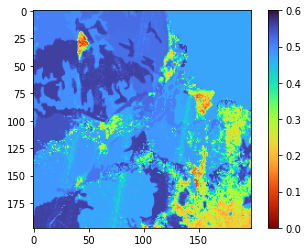

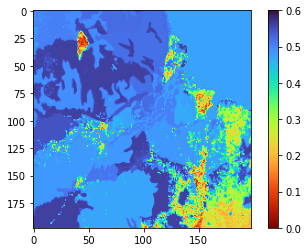

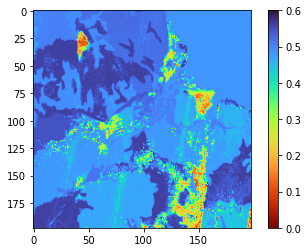

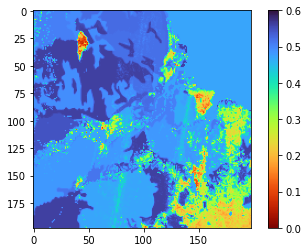

...

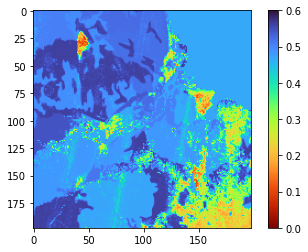

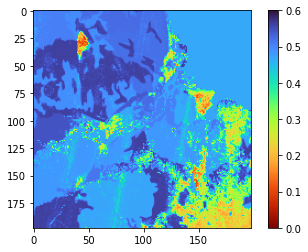

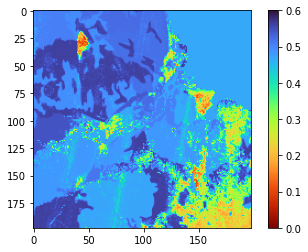

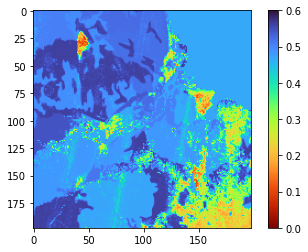

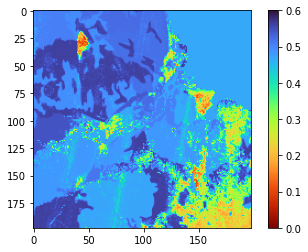

In [342]:
for x in arr6km:
    plt.figure()
    plt.imshow(x,cmap='turbo_r',vmin=0,vmax=.6)
    plt.colorbar()

In [343]:
x = sorted(glob.glob('smap_l3_03km_np_amazon/*.npy')) #strings of all 3km amazon files
xx = [z[35:43] for z in x]
print(xx)
z = sorted(glob.glob('smap_l3_36km_downto_6km/*.pt')) #strings of 36km at 6km amazon left after getting rid of those with less than .65 % radiometer pixels
z = [x[49:57] for x in z]
print(z)
# print(x)
for idy,y in enumerate(arr6km):
    if xx[idy] in z:
        torch.save(y,f'smap_l3_3km_upto_6km/radar_6km_{xx[idy]}.pt')

['20150413', '20150414', '20150415', '20150416', '20150417', '20150418', '20150419', '20150420', '20150421', '20150422', '20150423', '20150424', '20150425', '20150426', '20150427', '20150428', '20150429', '20150430', '20150501', '20150502', '20150503', '20150504', '20150505', '20150506', '20150507', '20150508', '20150509', '20150510', '20150511', '20150512', '20150514', '20150515', '20150516', '20150517', '20150518', '20150519', '20150520', '20150521', '20150522', '20150523', '20150524', '20150525', '20150526', '20150527', '20150528', '20150529', '20150530', '20150531', '20150601', '20150602', '20150603', '20150604', '20150605', '20150606', '20150607', '20150608', '20150609', '20150610', '20150611', '20150612', '20150613', '20150614', '20150615', '20150617', '20150618', '20150619', '20150620', '20150621', '20150622', '20150623', '20150624', '20150625', '20150626', '20150627', '20150628', '20150629', '20150630', '20150701', '20150702', '20150703', '20150704', '20150705', '20150706', '20

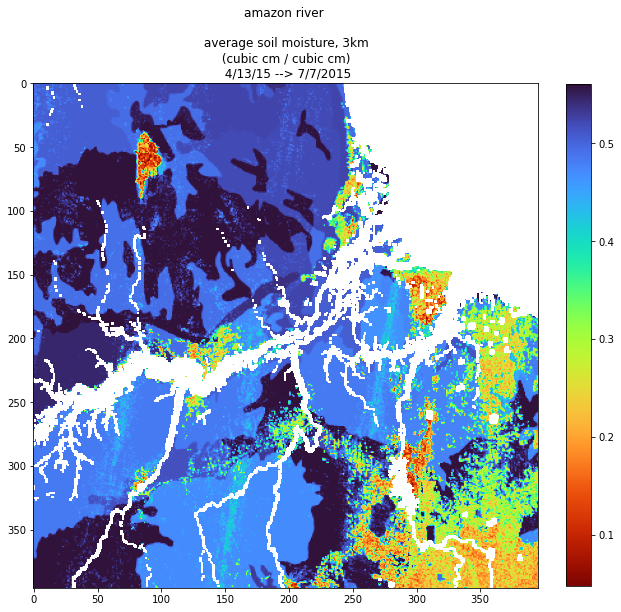

In [367]:
plt.figure(figsize=(10,10))
plt.gca().set_aspect('equal')
plt.imshow(arrmean,cmap='turbo_r')
plt.title('amazon river \n \n average soil moisture, 3km \n (cubic cm / cubic cm) \n 4/13/15 --> 7/7/2015')
plt.colorbar(fraction=.045)
np.save(f'radar_dset_mean.npy',arrmean)

In [69]:
arr.shape

(400, 400)

In [36]:
y[16:]

'smlatlon20150413.npy'

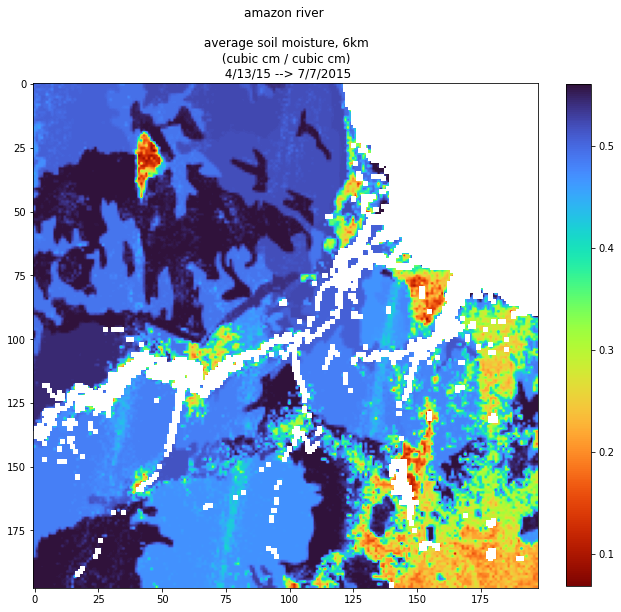

In [115]:
def x2d_torch4d(a):
    return torch.from_numpy(np.asarray(a)).unsqueeze(0).unsqueeze(0).float()


def nanmeanconv(arr,kernel_size):
   
    #input array should be 4-dim, typically [1,1,x,y]
    #kern should be the same
   
    unfold = torch.nn.Unfold(kernel_size=(kernel_size,kernel_size),stride=(kernel_size,kernel_size))
    m_unfold = unfold(arr).permute(2,0,1).reshape(-1,1,kernel_size,kernel_size)
    m_unfold_means = torch.FloatTensor([torch.nanmean(i) for i in m_unfold])
    m_nanmean_folded = torch.reshape(m_unfold_means,(arr.shape[2]//kernel_size,arr.shape[3]//kernel_size))
   
    #outputs 2d array
   
    return m_nanmean_folded
arr6km = nanmeanconv(x2d_torch4d(arr),2)

plt.figure(figsize=(10,10))
plt.gca().set_aspect('equal')
plt.imshow(arr6km,cmap='turbo_r')
plt.title('amazon river \n \n average soil moisture, 6km \n (cubic cm / cubic cm) \n 4/13/15 --> 7/7/2015')
plt.colorbar(fraction=.045)

In [266]:
x = glob.glob('smap_l3_36km/*.h5')

In [150]:
len(x)

87

/tmp/ipykernel_647923/3337871875.py:42: RuntimeWarning: Mean of empty slice
  sm_1dayavg = np.nanmean(sm_1day,axis=0) #gives am/pm average


868
non nan percentage: 	 0.7970615243342516
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
332
379
790
non nan percentage: 	 0.7254361799816346
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
107
628
600
138
872
non nan percentage: 	 0.800734618916437
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
342
393
797
non nan percentage: 	 0.7318640955004592
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
104
639
598
141
876
non nan percentage: 	 0.8044077134986226
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
332
401
787
non nan percentage: 	 0.7226813590449954
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
97
635
603
146
881
non nan percentage: 	 0.8089990817263545


/tmp/ipykernel_647923/3337871875.py:70: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(5,5))


6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
333
405
783
non nan percentage: 	 0.71900826446281
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
97
321
0
888
non nan percentage: 	 0.8154269972451791
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
334
407
781
non nan percentage: 	 0.7171717171717171
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
93
652
597
150
877
non nan percentage: 	 0.8053259871441689
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
338
404
783
non nan percentage: 	 0.71900826446281
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
92
651
591
149
881
non nan percentage: 	 0.8089990817263545
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
330
404
791
non nan percentage: 	 0.7263544536271809
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])
96
649
602
149
891
non nan percentage: 	 0.8181818181818182
6km number of bytes 	 156872
6km shape

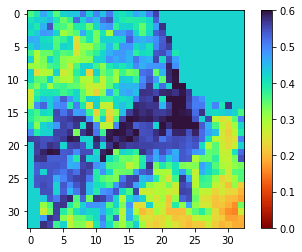

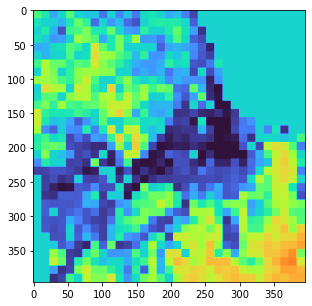

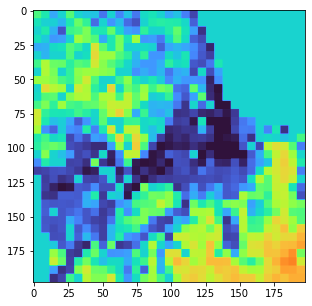

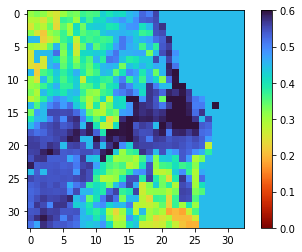

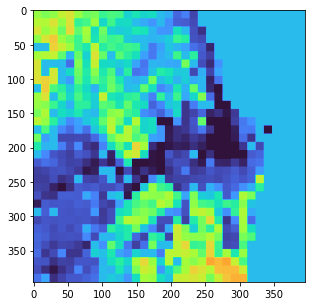

...

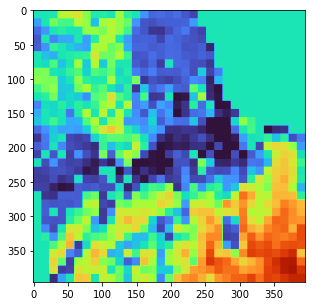

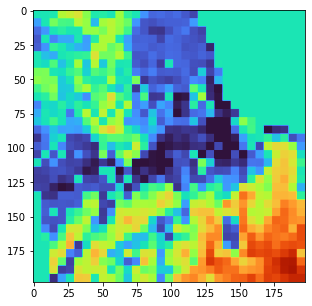

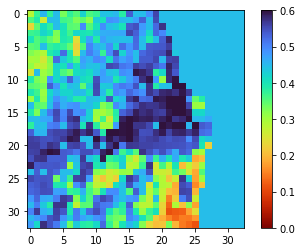

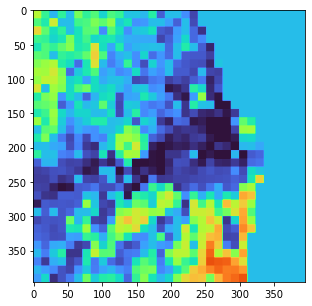

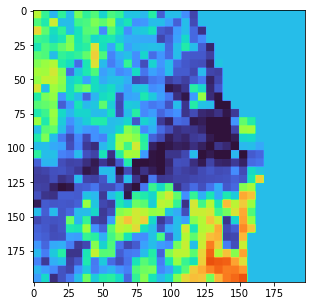

In [268]:
for xtarg in x:
    f = h5py.File(xtarg,'r')

#     for idk,key in enumerate(f.keys()):
#         print(idk,key)
#     print('\n')
    group_id_am = list(f.keys())[1]
#     for idv,var in enumerate(list(f[group_id_am].keys())):
#         print(idv,var)

    sm_idx_am = list(f[group_id_am].keys())[26]

#     print('\n')
    group_id_pm = list(f.keys())[2]
#     for idv,var in enumerate(list(f[group_id_pm].keys())):
#         print(idv,var)

    sm_idx_pm = list(f[group_id_pm].keys())[28]

    sm = np.expand_dims(np.asarray(f[group_id_pm][sm_idx_pm]),0); 
#     print(f'sm pm global shape: \t {sm.shape}')
    sm = np.where(sm<0,np.nan,sm)
    sm_pm = sm[0,(2300//12):(2700-4)//12,3900//12:(4300-4)//12] #changed 2700 to 2699 for bottom row consideration
#     print(f'sm amazon shape: \t {sm_pm.shape}')
#     plt.figure()
#     plt.imshow(sm_pm,cmap='turbo_r',vmin=0,vmax=.6)
#     plt.colorbar()
    # 2300:2700,3900:4300
    sm = np.expand_dims(np.asarray(f[group_id_am][sm_idx_am]),0); 
#     print(f'sm am global shape: \t {sm.shape}')
    sm = np.where(sm<0,np.nan,sm)
    sm_am = sm[0,(2300//12):(2700-4)//12,3900//12:(4300-4)//12] #changed 2700 to 2699 for bottom row consideration
#     print(f'sm amazon shape: \t {sm_am.shape}')
#     plt.figure()
#     plt.imshow(sm_am,cmap='turbo_r',vmin=0,vmax=.6)
#     plt.colorbar()
    # 2300:2700,3900:4300
    sm_am3d = np.expand_dims(sm_am,0)
    sm_pm3d = np.expand_dims(sm_pm,0)
    sm_1day = np.concatenate((sm_am3d,sm_pm3d),axis=0)
    
    sm_1dayavg = np.nanmean(sm_1day,axis=0) #gives am/pm average 
    np.save(f'smap_l3_36km_ampmavg/radiom_36km_ampmavg{xtarg[26:34]}.npy',sm_1dayavg)
    
    sm_nonnans = np.where(np.isfinite(sm_1dayavg)==False,0,1); 
    sm_nonnans = np.sum(sm_nonnans); 
    print(sm_nonnans)
    sm_nonnans_percent = sm_nonnans / (sm_1dayavg.shape[0]*sm_1dayavg.shape[1])
    if sm_nonnans_percent < .65:
        continue
    print(f'non nan percentage: \t {sm_nonnans_percent}')
    
    
    sm_1dayavg = np.where(np.isfinite(sm_1dayavg)==False,np.nanmean(sm_1dayavg),sm_1dayavg)
    plt.figure()
    plt.imshow(sm_1dayavg,cmap='turbo_r',vmin=0,vmax=.6)
    plt.colorbar()

    with Image.fromarray(sm_1dayavg) as im:

        # Provide the target width and height of the image
        (width, height) = (im.width * 12, im.height * 12)
        im_resized = np.asarray(im.resize((width, height),resample=Image.NEAREST))
    im_resized.shape   
#     print(f'3km number of bytes \t {sys.getsizeof(im_resized)}')
    plt.figure(figsize=(5,5))
    plt.imshow(im_resized,cmap='turbo_r',vmin=0,vmax=.6)
    # plt.colorbar()

    plt.figure(figsize=(5,5))
    # in_resized = np.where(im_resized==)
    im_resized_6km = nanmeanconv(x2d_torch4d(im_resized),2)
    plt.imshow(im_resized_6km,cmap='turbo_r',vmin=0,vmax=.6)

    torch.save(im_resized_6km,f'smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_{xtarg[26:34]}.pt')

    print(f'6km number of bytes \t {sys.getsizeof(im_resized_6km.storage())}')
    print(f'6km shape \t \t{im_resized_6km.shape}')


tensor shape 	 (85, 33, 33)
mean shape 	 (33, 33)
std shape 	 (33, 33)
arrmean shape: 	 (33, 33)
arrstd shape: 	 (33, 33)


/tmp/ipykernel_647923/142766519.py:10: RuntimeWarning: Mean of empty slice
  arrmean = np.nanmean(arr,axis=0)
/tmp/ipykernel_647923/142766519.py:30: RuntimeWarning: divide by zero encountered in true_divide
  zscore = (arrbool-arrmean)/arrstd
/tmp/ipykernel_647923/142766519.py:30: RuntimeWarning: invalid value encountered in true_divide
  zscore = (arrbool-arrmean)/arrstd


ValueError: supplied range of [-3.1274673253107097, inf] is not finite

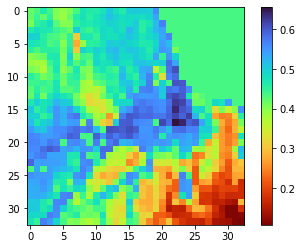

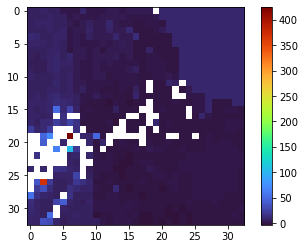

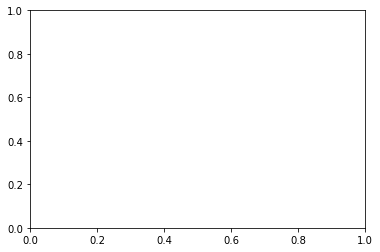

In [264]:
x = glob.glob('smap_l3_36km_ampmavg/*.npy')
np.load(x[0]).shape
arr = np.empty((0,33,33))

for y in x:
    z = np.load(y)
    a = np.expand_dims(z,0)
    arr = np.concatenate((a,arr),axis=0)
print(f'tensor shape \t {arr.shape}')
arrmean = np.nanmean(arr,axis=0)
arrmean = np.where(np.isfinite(arrmean)==False,np.nanmean(arrmean),arrmean)
arrstd = np.nanstd(arr,axis=0)
arrstd = np.where(np.isfinite(arrstd)==False,np.nanmean(arrstd),arrstd)

print(f'mean shape \t {arrmean.shape}')
print(f'std shape \t {arrstd.shape}')

plt.figure()
plt.imshow(arrmean,cmap='turbo_r')
plt.colorbar()

arrmeantile = np.tile(arrmean,(85,1,1))
arrstdtile = np.tile(arrstd,(85,1,1))
print(f'arrmean shape: \t {arrmean.shape}')
print(f'arrstd shape: \t {arrstd.shape}')

arrbool = np.where((np.isfinite(arr) == False) | (np.isfinite(arrmeantile)==False) | (np.isfinite(arrstdtile)==False), 0, arr)


zscore = (arrbool-arrmean)/arrstd
anom.shape
plt.figure()
plt.imshow(anom[0],cmap='turbo')
plt.colorbar()

In [220]:
x[42][26:34]

'20150526'

sm global shape: 	 (1, 406, 964)
sm amazon shape: 	 (33, 33)


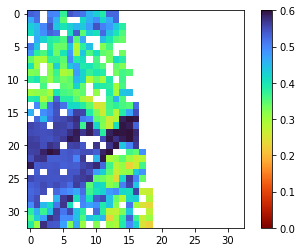

In [207]:
x = glob.glob('smap_l3_03km_np_amazon/*.npy')
len(x)
arr = np.empty((0,396,396))

for y in x:
    z = np.load(y)[:,:-4,:-4]
    a = np.expand_dims(z[0],0)
#     print(a.shape)
    arr = np.concatenate((a,arr),axis=0)
#     print(arr.shape)
#     break
arr = np.nanmean(arr,axis=0)
print(arr.shape)

sm global shape: 	 (1, 406, 964)
sm amazon shape: 	 (33, 33)


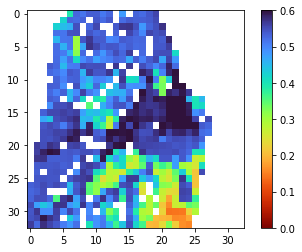

In [194]:
import sys

/tmp/ipykernel_647923/2012500645.py:5: RuntimeWarning: Mean of empty slice
  sm_1dayavg = np.nanmean(sm_1day,axis=0)


3km number of bytes 	 627384
6km number of bytes 	 156872
6km shape 	 	torch.Size([198, 198])


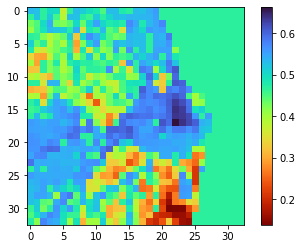

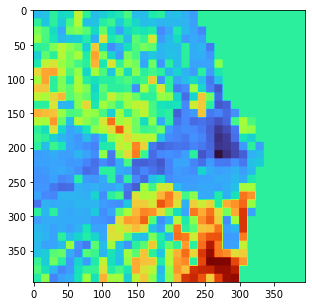

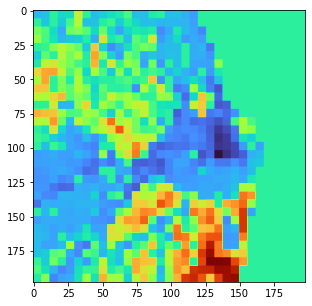

In [183]:
np.nanmean(sm_1dayavg)

0.4691938

In [181]:
sm_1dayavg[0,-1]

nan

In [ ]:
sm_1day = np.nanmean([])

In [117]:
from PIL import Image

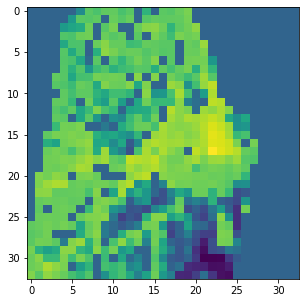

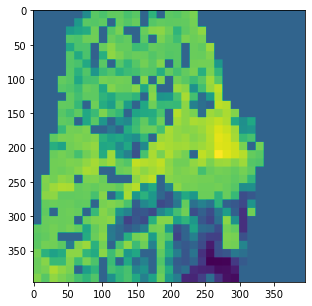

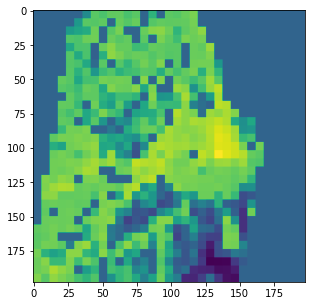

In [147]:
smtarg = np.where(smtarg==0,np.nanmean(smtarg),smtarg)
plt.figure(figsize=(5,5))
plt.imshow(smtarg)
# plt.colorbar()
with Image.fromarray(smtarg) as im:

    # Provide the target width and height of the image
    (width, height) = (im.width * 12, im.height * 12)
    im_resized = np.asarray(im.resize((width, height),resample=Image.NEAREST))
im_resized.shape   
plt.figure(figsize=(5,5))
plt.imshow(im_resized)
# plt.colorbar()

plt.figure(figsize=(5,5))
# in_resized = np.where(im_resized==)
im_resized_6km = nanmeanconv(x2d_torch4d(im_resized),2)
plt.imshow(im_resized_6km)

In [ ]:
x = sorted(glob.glob('smap_l3_03km/*.h5'))

for xtarg in x:
    f = h5py.File(xtarg,'r')
#     for idk,key in enumerate(f.keys()):
#         print(idk,key)
#     print('\n')
    group_id = list(f.keys())[3]
#     for idv,var in enumerate(list(f[group_id].keys())):
#         print(idv,var)
    sm_idx = list(f[group_id].keys())[18]
    sm_lat = list(f[group_id].keys())[4]
    sm_lon = list(f[group_id].keys())[5]

    print('\n')
    print(f'filename: \t {xtarg}')
    sm = np.expand_dims(np.asarray(f[group_id][sm_idx]),0); print(f'sm shape: \t {sm.shape}')
    lat = np.expand_dims(np.asarray(f[group_id][sm_lat]),0); print(f'lat shape: \t {lat.shape}')
    lon = np.expand_dims(np.asarray(f[group_id][sm_lon]),0); print(f'lon shape: \t {lon.shape}')

    tensor = np.concatenate((sm,lat,lon),axis=0)
    tensor.shape
    np.save(f'smap_l3_03km_np/smlatlon{xtarg[26:34]}.npy',tensor)

(198, 198)


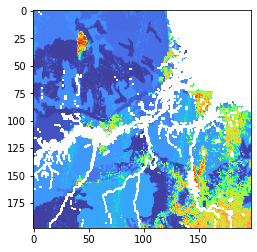

In [373]:
with Image.fromarray(arrmean) as arrmean3km:
    (width, height) = (arrmean3km.width // 2, arrmean3km.height //2)
    arrmean6km = np.asarray(arrmean3km.resize((width, height),resample=Image.NEAREST))
plt.imshow(arrmean6km,cmap='turbo_r',vmin=0,vmax=0.6)
print(arrmean6km.shape)
np.save('radar_dset_mean_6km.npy',arrmean6km)

lo len 	 21 
hi len 	 21
1 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150413.pt smap_l3_3km_upto_6km/radar_6km_20150413.pt
torch.Size([198, 198])
torch.Size([198, 198])


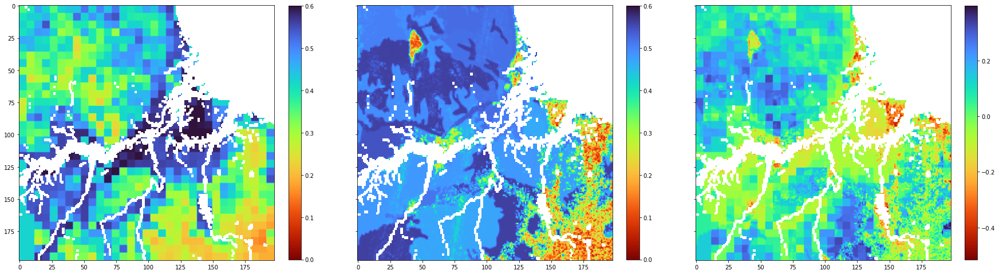

2 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150416.pt smap_l3_3km_upto_6km/radar_6km_20150416.pt
torch.Size([198, 198])
torch.Size([198, 198])


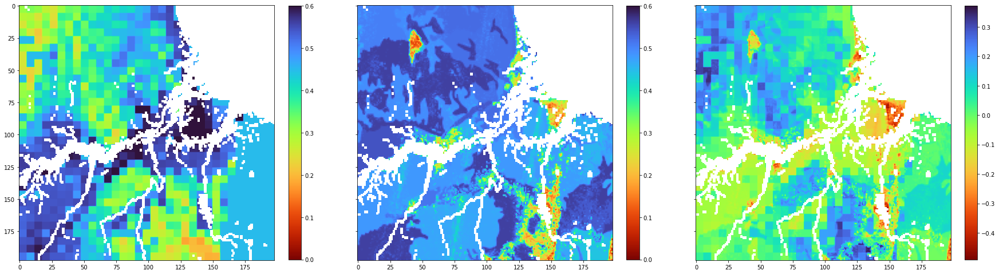

3 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150421.pt smap_l3_3km_upto_6km/radar_6km_20150421.pt
torch.Size([198, 198])
torch.Size([198, 198])


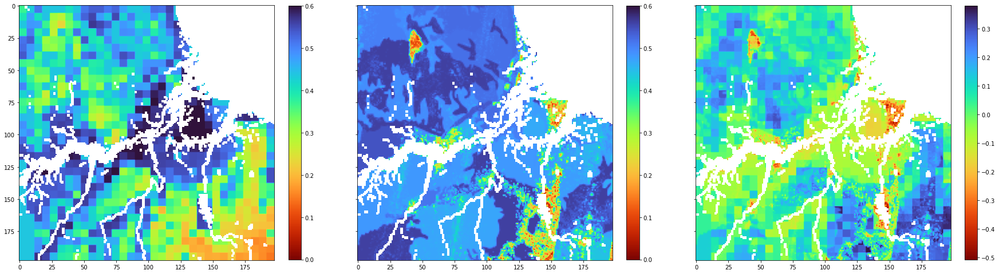

4 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150424.pt smap_l3_3km_upto_6km/radar_6km_20150424.pt
torch.Size([198, 198])
torch.Size([198, 198])


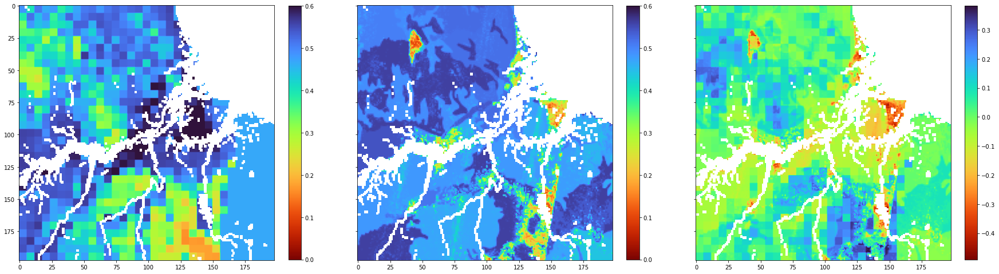

5 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150429.pt smap_l3_3km_upto_6km/radar_6km_20150429.pt
torch.Size([198, 198])
torch.Size([198, 198])


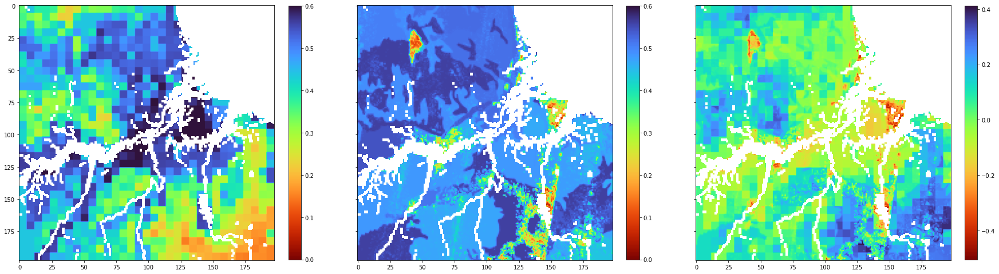

6 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150502.pt smap_l3_3km_upto_6km/radar_6km_20150502.pt
torch.Size([198, 198])
torch.Size([198, 198])


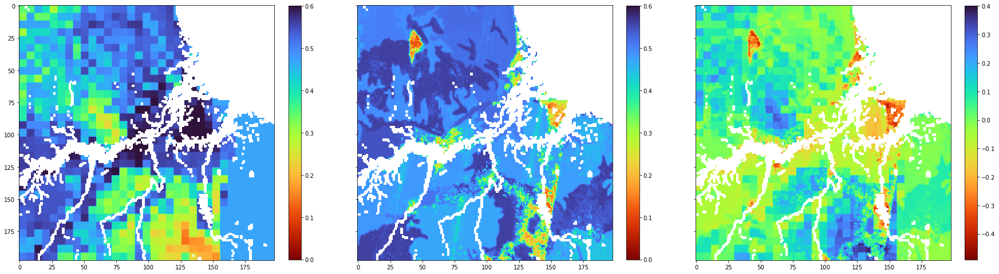

7 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150507.pt smap_l3_3km_upto_6km/radar_6km_20150507.pt
torch.Size([198, 198])
torch.Size([198, 198])


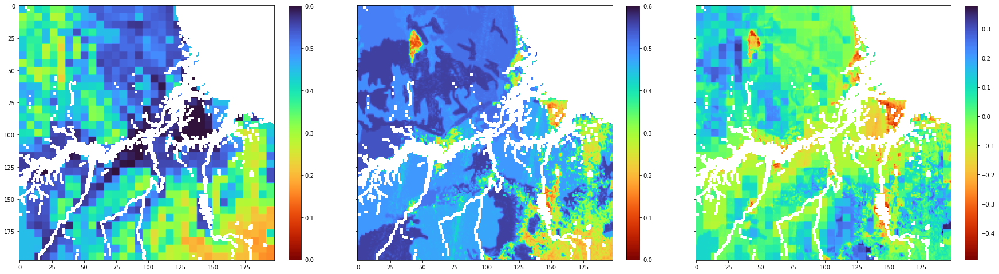

8 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150510.pt smap_l3_3km_upto_6km/radar_6km_20150510.pt
torch.Size([198, 198])
torch.Size([198, 198])


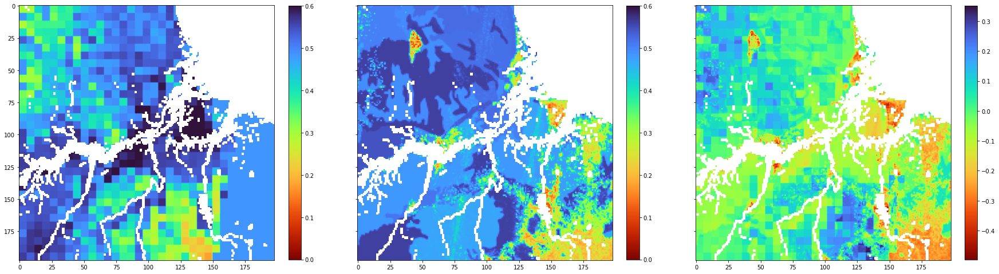

9 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150515.pt smap_l3_3km_upto_6km/radar_6km_20150515.pt
torch.Size([198, 198])
torch.Size([198, 198])


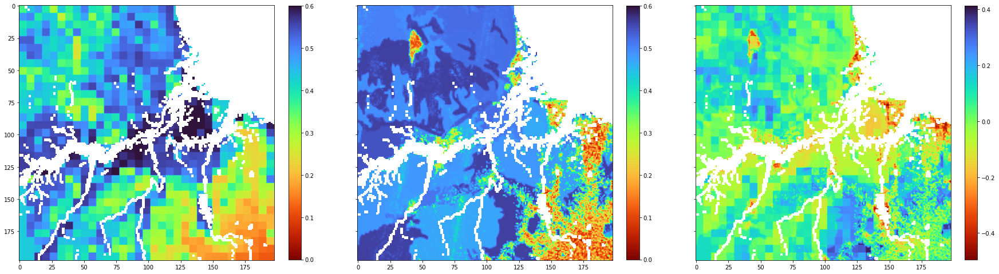

10 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150518.pt smap_l3_3km_upto_6km/radar_6km_20150518.pt
torch.Size([198, 198])
torch.Size([198, 198])


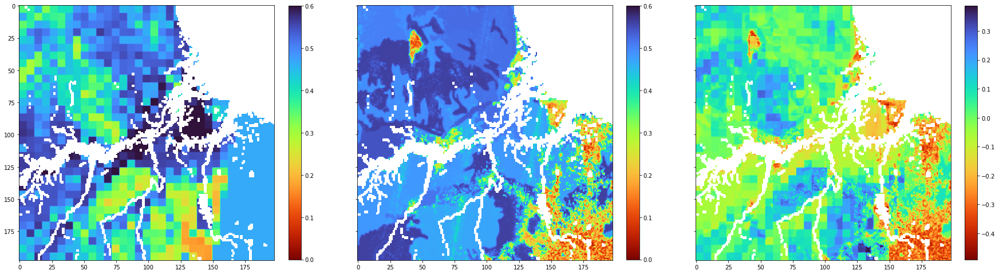

11 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150523.pt smap_l3_3km_upto_6km/radar_6km_20150523.pt
torch.Size([198, 198])
torch.Size([198, 198])


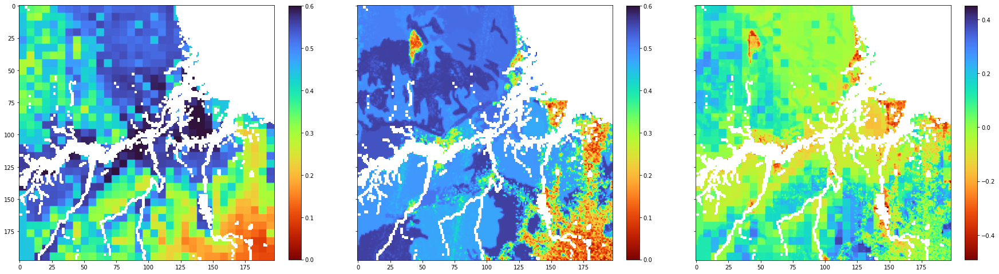

12 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150526.pt smap_l3_3km_upto_6km/radar_6km_20150526.pt
torch.Size([198, 198])
torch.Size([198, 198])


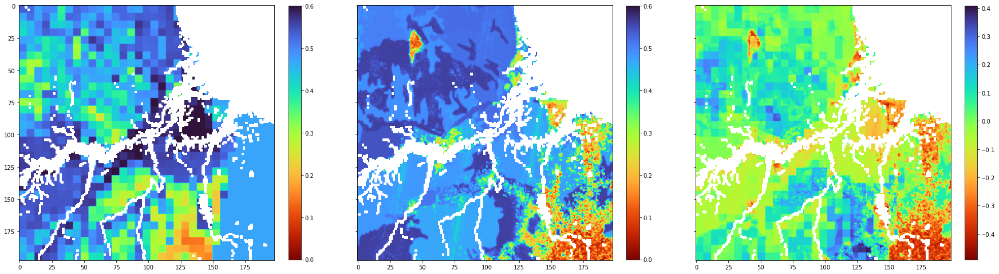

13 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150531.pt smap_l3_3km_upto_6km/radar_6km_20150531.pt
torch.Size([198, 198])
torch.Size([198, 198])


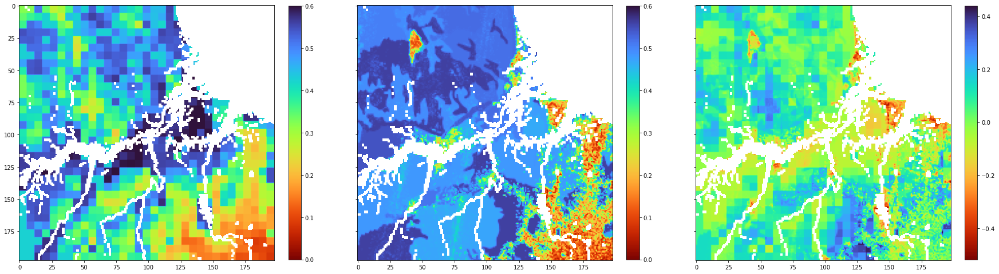

14 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150603.pt smap_l3_3km_upto_6km/radar_6km_20150603.pt
torch.Size([198, 198])
torch.Size([198, 198])


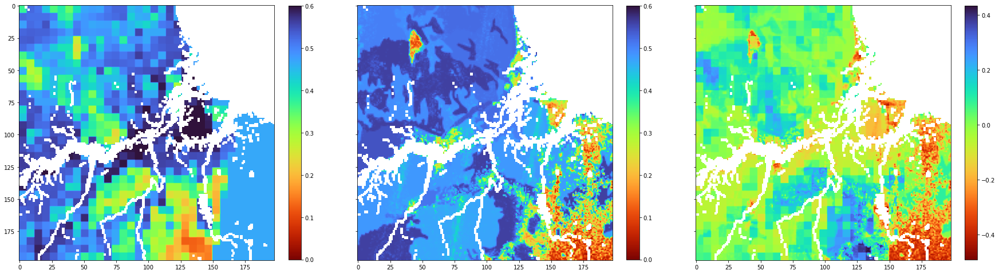

15 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150608.pt smap_l3_3km_upto_6km/radar_6km_20150608.pt
torch.Size([198, 198])
torch.Size([198, 198])


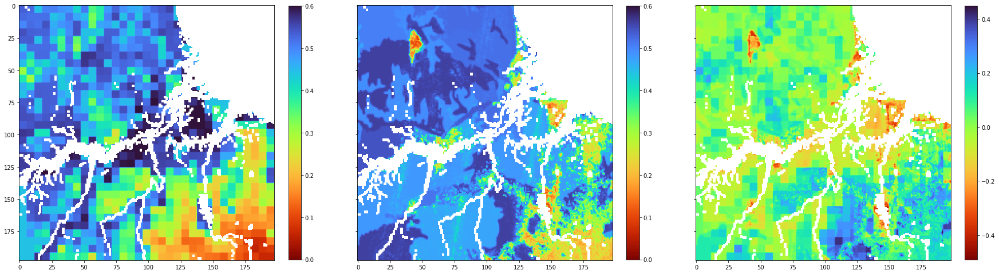

16 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150611.pt smap_l3_3km_upto_6km/radar_6km_20150611.pt
torch.Size([198, 198])
torch.Size([198, 198])


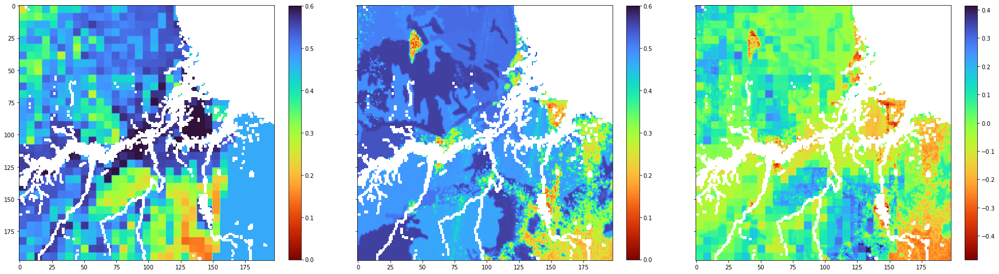

17 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150619.pt smap_l3_3km_upto_6km/radar_6km_20150619.pt
torch.Size([198, 198])
torch.Size([198, 198])


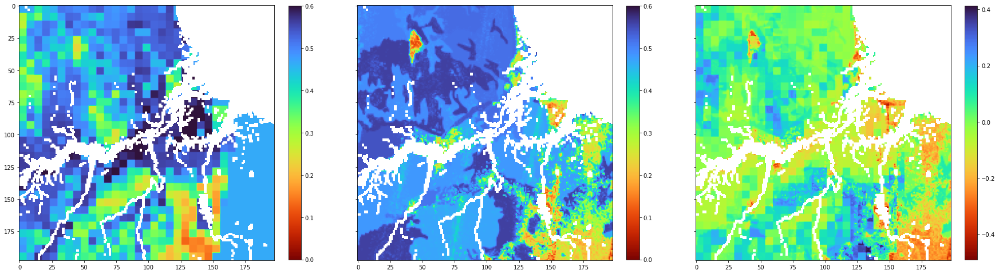

18 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150624.pt smap_l3_3km_upto_6km/radar_6km_20150624.pt
torch.Size([198, 198])
torch.Size([198, 198])


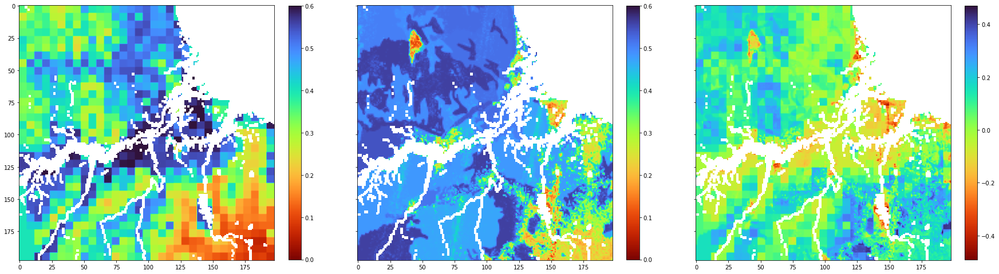

19 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150627.pt smap_l3_3km_upto_6km/radar_6km_20150627.pt
torch.Size([198, 198])
torch.Size([198, 198])


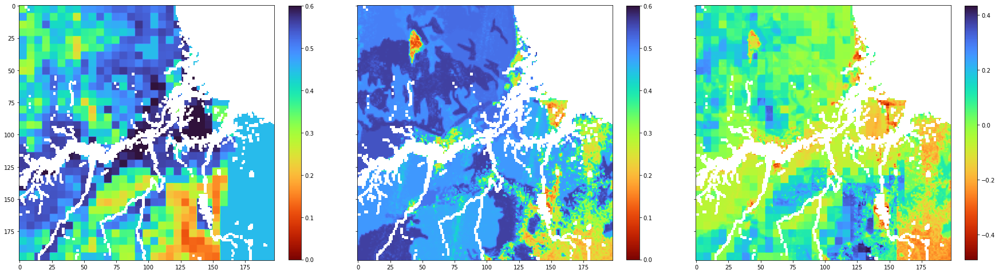

20 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150702.pt smap_l3_3km_upto_6km/radar_6km_20150702.pt
torch.Size([198, 198])
torch.Size([198, 198])


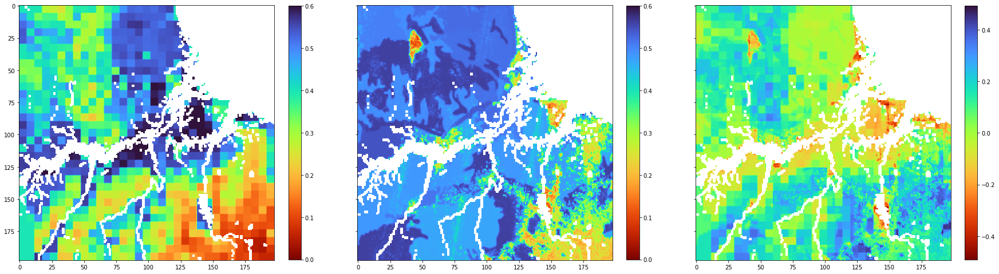

21 smap_l3_36km_downto_6km/radiom_ampm_36_to_3_to_6_20150705.pt smap_l3_3km_upto_6km/radar_6km_20150705.pt
torch.Size([198, 198])
torch.Size([198, 198])


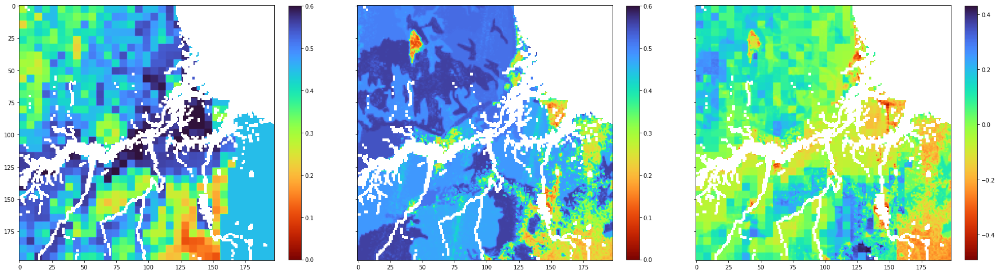

In [377]:
lo = sorted(glob.glob('smap_l3_36km_downto_6km/*.pt'))
hi = sorted(glob.glob('smap_l3_3km_upto_6km/*.pt'))

print(f'lo len \t {len(lo)} \nhi len \t {len(hi)}')

for idx, x in enumerate(lo):
    print(idx+1, x, hi[idx])
    lo1 = torch.load(x)
    hi1 = torch.load(hi[idx])
    print(lo1.shape)
    print(hi1.shape)
    

    fig,(ax1,ax2,ax3) = plt.subplots(1,3,sharex = True,sharey=True,figsize=(30,10))
    z1_plot = ax1.imshow(np.where(np.isfinite(arrmean6km)==False,np.nan,lo1),cmap='turbo_r',vmin=0,vmax=0.6)
    plt.colorbar(z1_plot,ax=ax1,fraction=.045)
    z2_plot = ax2.imshow(np.where(np.isfinite(arrmean6km)==False,np.nan,hi1),cmap='turbo_r',vmin=0,vmax=0.6)
    plt.colorbar(z1_plot,ax=ax2,fraction=.045)
    z3_plot = ax3.imshow(np.where(np.isfinite(arrmean6km)==False,np.nan,hi1-lo1),cmap='turbo_r')
    plt.colorbar(z3_plot,ax=ax3,fraction=.045)
    plt.show()
    

